In [13]:
# Import main librairies
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import preprocessing, decomposition
from sklearn.manifold import TSNE

# For images
from IPython.display import Image

# Ignore warning parts
import warnings
warnings.filterwarnings("ignore")

In [6]:
# Import dataset
data = pd.read_csv('data_clustering.csv', sep=';')

In [7]:
data

,Customer,deliveries,order_purchase_timestamp,last_order_days,payments_total,review_score_mean,number_of_review_comments,number_of_purchases,Number_of_products,percentage_deliveries,percentage_of_review_comments,mean_payment_by_purchase
0,b7d76e111c89f7ebf14761390f0f7d17,0,2016-09-04 21:15:19,1996,72.89,1.0,1,1,2,0.0,100.0,72.89
1,4854e9b3feff728c13ee5fc7d1547e92,0,2016-09-05 00:15:34,1996,59.50,1.0,1,1,1,0.0,100.0,59.50
2,830d5b7aaa3b6f1e9ad63703bec97d23,3,2016-09-15 12:16:38,1986,134.97,1.0,1,1,3,100.0,100.0,134.97
3,0eb1ee9dba87f5b36b4613a65074337c,0,2016-10-02 22:07:52,1968,100.00,1.0,0,1,1,0.0,0.0,100.00
4,2f64e403852e6893ae37485d5fcacdaf,1,2016-10-03 16:56:50,1967,21.90,4.0,1,1,1,100.0,100.0,21.90
...,...,...,...,...,...,...,...,...,...,...,...,...
94716,5c58de6fb80e93396e2f35642666b693,2,2018-08-29 14:18:23,1273,418.00,5.0,1,1,2,100.0,100.0,418.00
94717,7febafa06d9d8f232a900a2937f04338,1,2018-08-29 14:18:28,1273,45.90,5.0,1,1,1,100.0,100.0,45.90
94718,b701bebbdf478f5500348f03aff62121,1,2018-08-29 14:52:00,1272,24.90,3.0,0,1,1,100.0,0.0,24.90
94719,24ac2b4327e25baf39f2119e4228976a,1,2018-08-29 15:00:37,1272,84.99,5.0,0,1,1,100.0,0.0,84.99


## 1) Visualisation with 4 features - orders and satisfaction features :
- last_order_days
- number_of_purchases
- payments_total
- review_score_mean

In [8]:
data_4 = data[['Customer', 
               'number_of_purchases', 
               'payments_total', 
               'last_order_days',
               'review_score_mean']]

data_4 = data_4.set_index('Customer')

In [9]:
X4 = data_4.values
X4.shape

(94721, 4)

In [12]:
# Standardisation des données
std_scale = preprocessing.StandardScaler().fit(X4)
X4_scaled = std_scale.transform(X4)

### t-SNE (t-Stochastic Neighbour Embedding) on entire dataset

In [14]:
# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100 = tsne.fit_transform(X4_scaled)
tsne_result_p100.shape

(94721, 2)

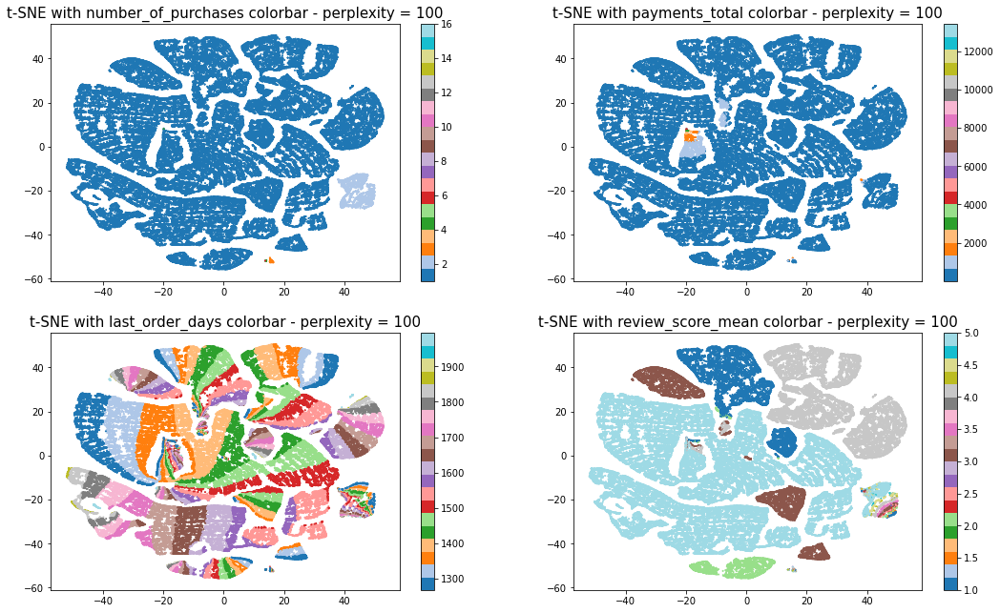

In [16]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

list_feat_4 = ['number_of_purchases', 'payments_total', 
               'last_order_days', 'review_score_mean']

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 100', size = 15)
    plt.colorbar()

plt.show()

In [17]:
# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 1)
tsne_result_p100_1 = tsne.fit_transform(X4_scaled)
tsne_result_p100_1.shape

(94721, 2)

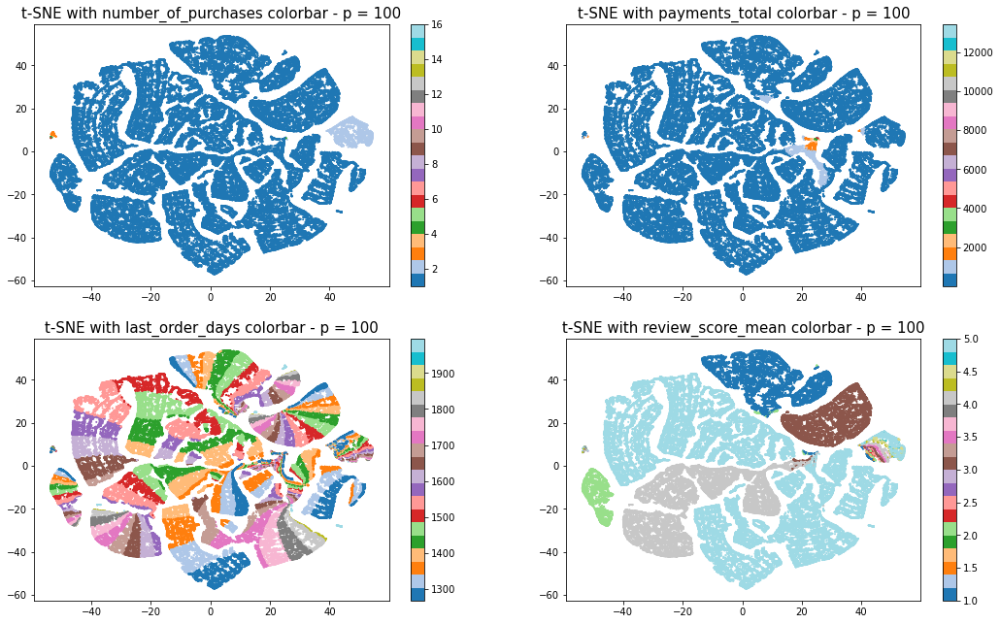

In [18]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_1 = pd.DataFrame(tsne_result_p100_1, columns=['tsne1', 'tsne2'])

list_feat_4 = ['number_of_purchases', 'payments_total', 
               'last_order_days', 'review_score_mean']

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_1['tsne1'], 
                tsne_results_p100_1['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100', size = 15)
    plt.colorbar()

plt.show()

In [19]:
# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'pca',
            perplexity = 100,
            n_iter = 1000,
            random_state = 1)
tsne_result_p100_1_pca = tsne.fit_transform(X4_scaled)
tsne_result_p100_1_pca.shape

(94721, 2)

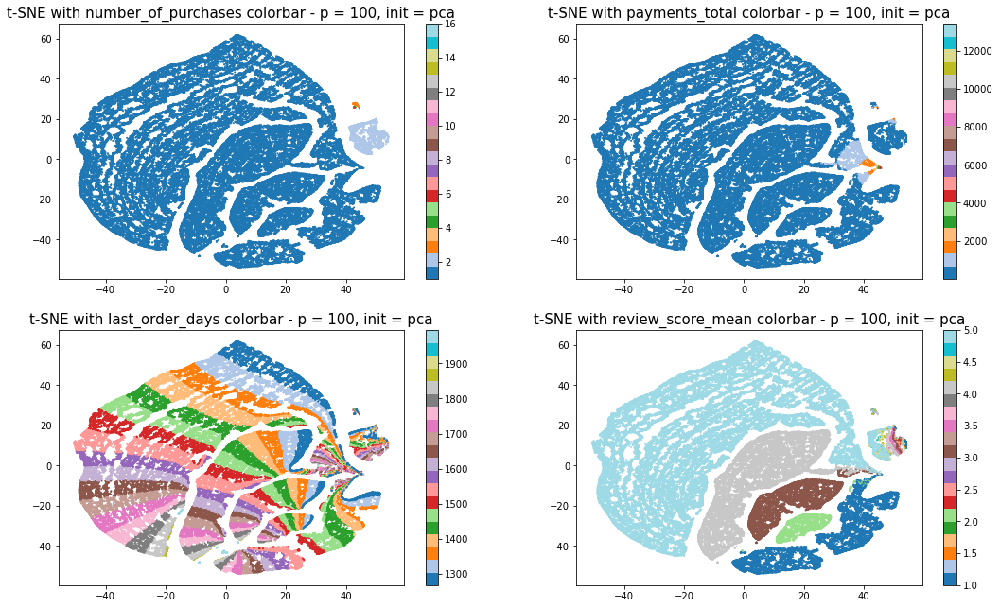

In [20]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_1_pca = pd.DataFrame(tsne_result_p100_1_pca, columns=['tsne1', 'tsne2'])

list_feat_4 = ['number_of_purchases', 'payments_total', 
               'last_order_days', 'review_score_mean']

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_1_pca['tsne1'], 
                tsne_results_p100_1_pca['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100, init = pca', size = 15)
    plt.colorbar()

plt.show()

# 4) Clustering

## 4) a) clustering With 4 features dataframe - orders and satisfaction features :

### KMeans clustering

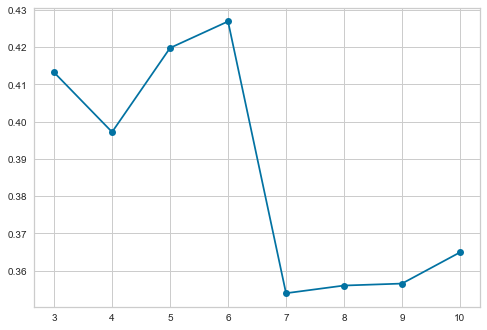

In [513]:
# Calculate silhouette scores for different number of clusters with Kmeans clustering
# on entire dataset
from sklearn.cluster import KMeans
from sklearn import metrics

silhouettes = []

for num_clusters in range(3, 11):
    cls = KMeans(n_clusters = num_clusters,
                 n_init = 10, 
                 init = 'k-means++')
    cls.fit(X4_scaled)
    silh = metrics.silhouette_score(X4_scaled, cls.labels_)
    silhouettes.append(silh)

plt.plot(range(3,11), silhouettes, marker = 'o');

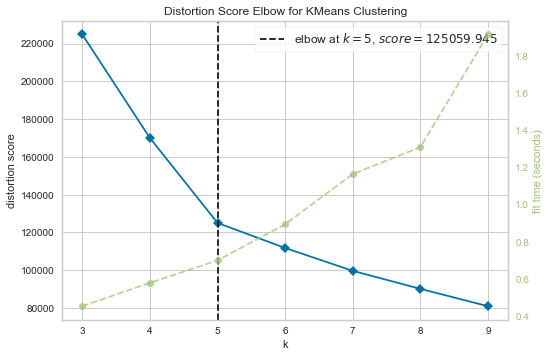

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [515]:
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

# Instantiate the clustering model and visualizer
model = KMeans(n_clusters = num_clusters,
               n_init = 10,
               init = 'k-means++')
visualizer = KElbowVisualizer(model, k=(3,10))

visualizer.fit(X4_scaled)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data

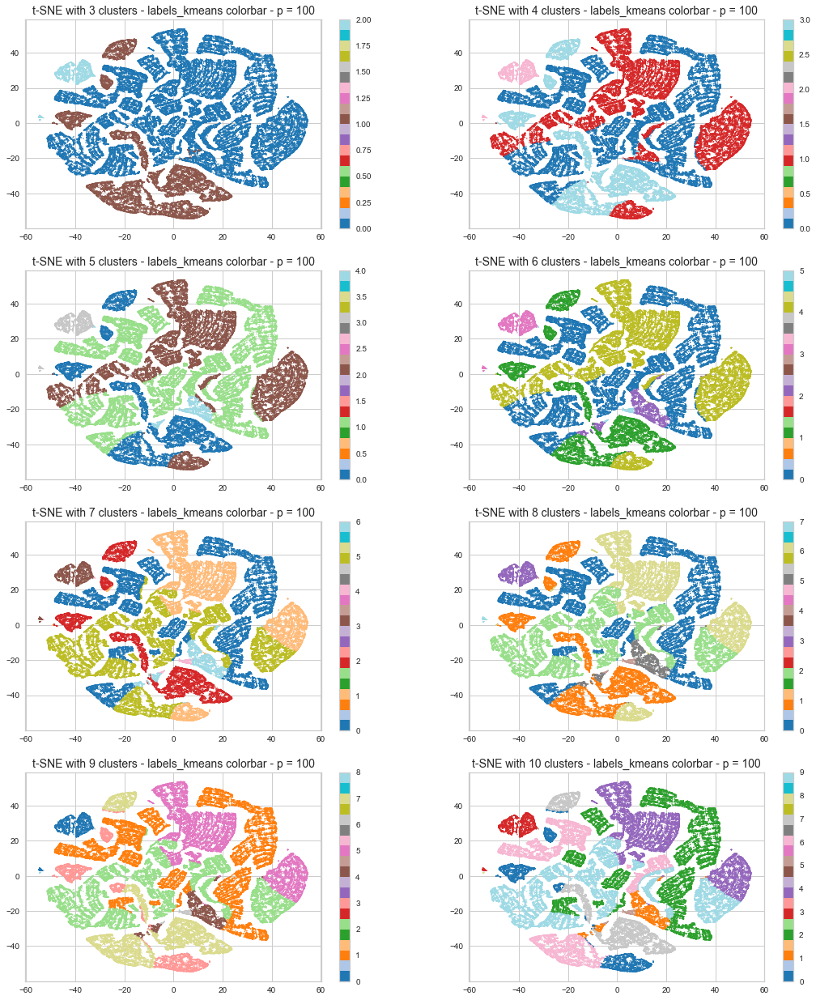

In [517]:
plt.figure(figsize = (18, 12))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, num_clusters in enumerate(range(3, 11)):
    km = KMeans(n_clusters = num_clusters,
                 max_iter = 300,
                 n_init = 10, 
                 init = 'k-means++')
    km.fit(X4_scaled)
    labels_k_means = km.labels_
    data_4['labels_kmeans'] = labels_k_means
    plt.subplot(4,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get('labels_kmeans'), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ str(num_clusters) + ' clusters - labels_kmeans colorbar - p = 100', size = 14)
    plt.colorbar()

plt.show()

In [194]:
from sklearn.cluster import KMeans
from sklearn import metrics

# Run local implementation of kmeans with 4 clusters
km = KMeans(n_clusters = 4, 
            max_iter = 100,
            n_init = 10,
            init = 'k-means++')
km.fit(X4_scaled)

labels_kmeans_4_clusters = km.labels_
data_4['labels_kmeans'] = labels_kmeans_4_clusters

In [526]:
list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_kmeans']

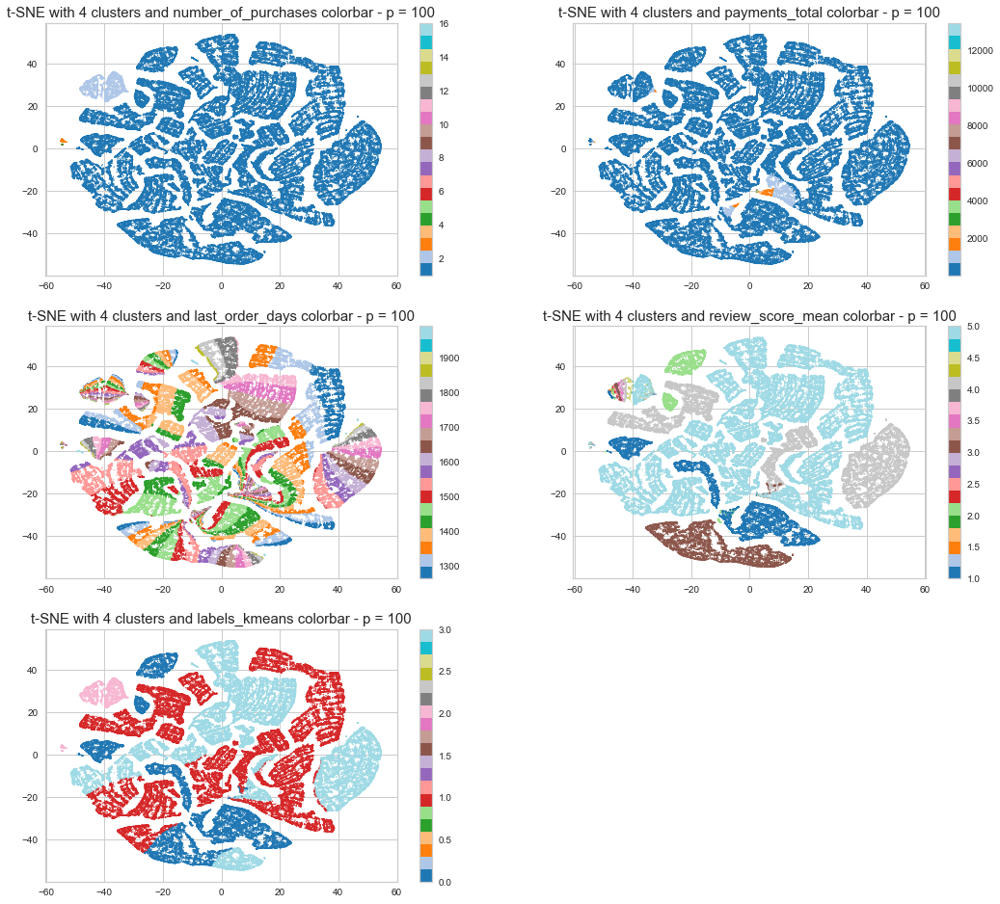

In [527]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with 4 clusters and '+ feat + ' colorbar - p = 100', size = 15)
    plt.colorbar()

plt.show()

In [195]:
from sklearn.cluster import KMeans
from sklearn import metrics

# Run local implementation of kmeans with 5 clusters
km = KMeans(n_clusters = 5, 
            max_iter = 100,
            n_init = 10,
            init = 'k-means++')
km.fit(X4_scaled)

labels_kmeans_5_clusters = km.labels_
data_4['labels_kmeans_5'] = labels_kmeans_5_clusters

In [196]:
list_feat_4_and_label_5 = ['number_of_purchases',
                           'payments_total',
                           'last_order_days',
                           'review_score_mean',
                           'labels_kmeans_5']

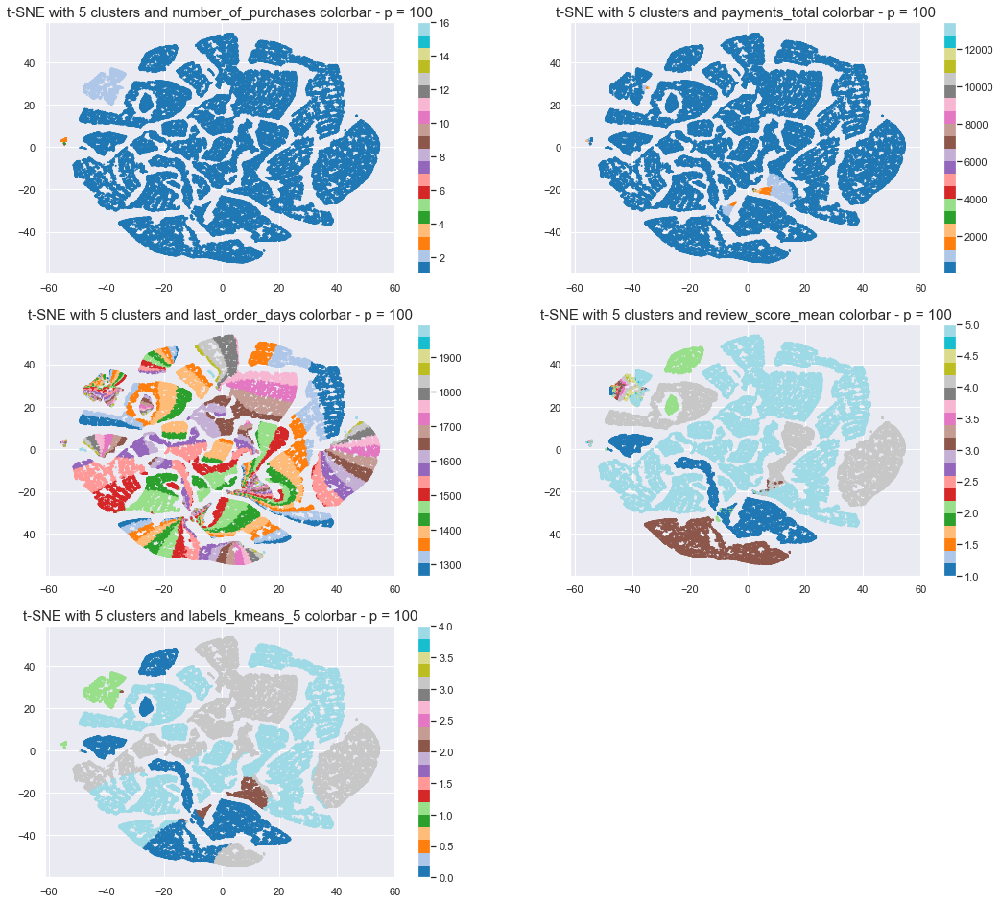

In [197]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label_5):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with 5 clusters and '+ feat + ' colorbar - p = 100', size = 15)
    plt.colorbar()

plt.show()

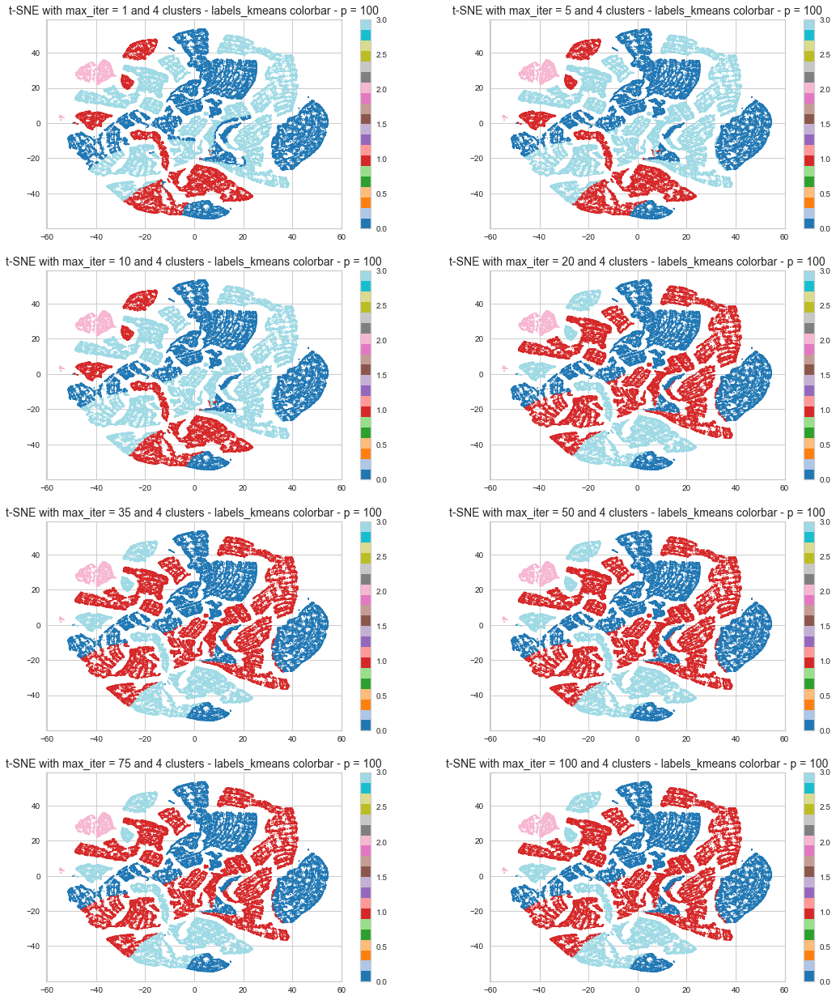

In [532]:
plt.figure(figsize = (18, 12))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, max_iterations in enumerate([1, 5, 10, 20, 35, 50, 75, 100]):
    km = KMeans(n_clusters = 4,
                 max_iter = max_iterations,
                 n_init = 10, 
                 init = 'k-means++',
                random_state = 0)
    km.fit(X4_scaled)
    labels_k_means = km.labels_
    data_4['labels_kmeans'] = labels_k_means
    plt.subplot(4,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get('labels_kmeans'), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with max_iter = '+ str(max_iterations) + ' and 4 clusters - labels_kmeans colorbar - p = 100', size = 14)
    plt.colorbar()

plt.show()

-> Le clustering n'évolue plus après 10 itérations

### Conclusion du clustering KMeans
- best choice would be 4 or 5 clusters
- low number of iteration (10) is sufficient
- to be compared with other clustering models

### KernelKMeans clustering

In [221]:
pip install tslearn

In [222]:
from tslearn.clustering import KernelKMeans

In [223]:
# Calculate silhouette scores for different number of clusters with Kmeans clustering
# on entire dataset
from sklearn import metrics

silhouettes = []

for num_clusters in range(3, 7):
    cls = KernelKMeans(n_clusters = num_clusters,
                       n_init = 1)
    cls.fit(X4_scaled)
    silh = metrics.silhouette_score(X4_scaled, cls.labels_)
    silhouettes.append(silh)

plt.plot(range(3,7), silhouettes, marker = 'o');

MemoryError: Unable to allocate 66.8 GiB for an array with shape (94721, 94721) and data type float64

In [224]:
# Run local implementation of kmeans with 4 clusters
kkm = KernelKMeans(n_clusters = 4,
                   max_iter = 50,
                   n_init = 1)
kkm.fit(X4_scaled)

labels_kkmeans_4_clusters = kkm.labels_
data_4['labels_kkmeans'] = labels_kkmeans_4_clusters

MemoryError: Unable to allocate 66.8 GiB for an array with shape (94721, 94721) and data type float64

### Hierarchical clustering

In [195]:
# Dendrogram on reduced dataset (number of purchases > 1)

from scipy.cluster.hierarchy import dendrogram, linkage

# Linkage Matrix
Z = linkage(X4_scaled, method = 'ward')
 
# plotting dendrogram
plt.figure(figsize = (18,8))
dendro = dendrogram(Z, p = 10, truncate_mode = 'level')
plt.title('Dendrogram')
plt.ylabel('Euclidean distance')
plt.show()

MemoryError: Unable to allocate 33.4 GiB for an array with shape (4485986560,) and data type float64

In [219]:
# Calculate silhouette scores for different number of clusters with AgglomerativeClustering
from sklearn.cluster import AgglomerativeClustering

silhouettes = []

for num_clusters in range(3, 7):
    agg_clustering = AgglomerativeClustering(n_clusters = num_clusters, 
                                             affinity = 'euclidean', 
                                             linkage = 'ward')
    # predicting the labels
    agg_clustering = agg_clustering.fit(X4_scaled)
    silh = metrics.silhouette_score(X4_scaled, agg_clustering.labels_)
    silhouettes.append(silh)

plt.plot(range(3, 7), silhouettes, marker='o');

MemoryError: Unable to allocate 33.4 GiB for an array with shape (4485986560,) and data type float64

### Conclusion for hierarchical clustering : the method is not adapted for the size of the dataset

### DBSCAN Clustering

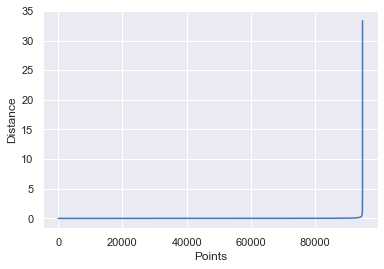

In [193]:
# Finding the Optimal value of Epsilon
from sklearn.neighbors import NearestNeighbors

nearest_neighbors  = NearestNeighbors(n_neighbors=5)
neighbors  = nearest_neighbors.fit(X4_scaled)

distances, indices = neighbors.kneighbors(X4_scaled)
distances = np.sort(distances[:,1], axis = 0)

plt.plot(distances)
plt.xlabel("Points")
plt.ylabel("Distance");

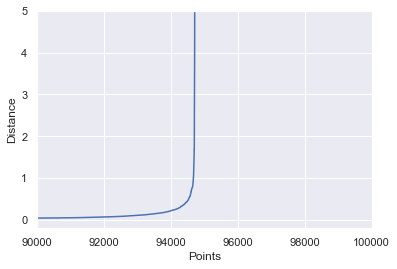

In [194]:
from sklearn.neighbors import NearestNeighbors

nearest_neighbors  = NearestNeighbors(n_neighbors=5)
neighbors  = nearest_neighbors.fit(X4_scaled)

distances, indices = neighbors.kneighbors(X4_scaled)
distances = np.sort(distances[:,1], axis = 0)

plt.plot(distances)
plt.xlabel("Points")
plt.ylabel("Distance")
plt.ylim(-0.2, 5)
plt.xlim(90000, 100000);

In [196]:
pip install kneed

Note: you may need to restart the kernel to use updated packages.


0.023004726848633722


<Figure size 360x360 with 0 Axes>

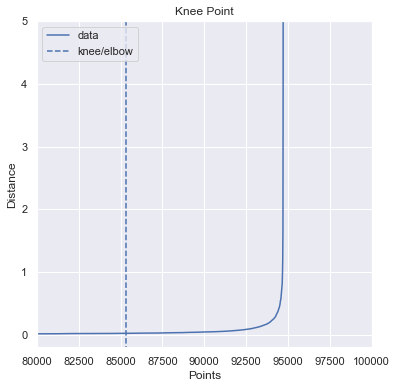

In [199]:
# Identifying Elbow Point with Kneed Package
from kneed import KneeLocator

i = np.arange(len(distances))
knee = KneeLocator(i, distances, S=1, curve='convex', direction='increasing', interp_method='polynomial')

fig = plt.figure(figsize=(5, 5))
knee.plot_knee()
plt.xlabel("Points")
plt.ylabel("Distance")
plt.ylim(-0.2, 5)
plt.xlim(80000, 100000);

print(distances[knee.knee])

In [201]:
from sklearn.cluster import DBSCAN

labels_DBSCAN_025_5 = DBSCAN(eps = 0.25, min_samples = 5).fit_predict(X4_scaled)

data_4['labels_DBSCAN_025_5'] = labels_DBSCAN_025_5

list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_DBSCAN_025_5']

# Number of Clusters
N_clus = len(set(labels_DBSCAN_025_5)) - (1 if -1 in labels_DBSCAN_025_5 else 0)
print('Estimated no. of clusters: %d' % N_clus)

# Identify Noise
n_noise = list(labels_DBSCAN_025_5).count(-1)
print('Estimated no. of noise points: %d' % n_noise)

Estimated no. of clusters: 65
Estimated no. of noise points: 1130


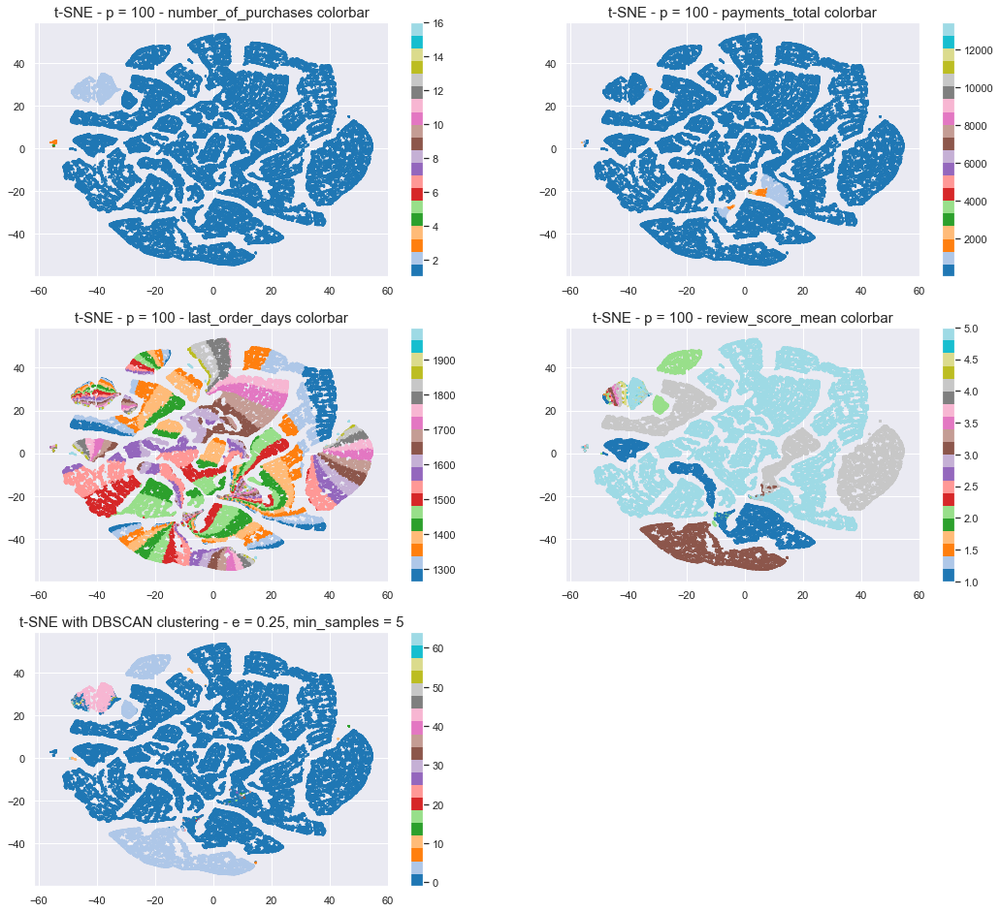

In [202]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE - p = 100 - '+ feat + ' colorbar', size = 15)
    plt.colorbar()

plt.title('t-SNE with DBSCAN clustering - e = 0.25, min_samples = 5', size = 15)
plt.show()

-> too many clusters with those parameters (epsilon = 0.25 - min_samples = 5)

In [203]:
from sklearn.cluster import DBSCAN

labels_DBSCAN_01_5 = DBSCAN(eps = 0.1, min_samples = 5).fit_predict(X4_scaled)

data_4['labels_DBSCAN_01_5'] = labels_DBSCAN_01_5

list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_DBSCAN_01_5']

# Number of Clusters
N_clus = len(set(labels_DBSCAN_01_5)) - (1 if -1 in labels_DBSCAN_01_5 else 0)
print('Estimated no. of clusters: %d' % N_clus)

# Identify Noise
n_noise = list(labels_DBSCAN_01_5).count(-1)
print('Estimated no. of noise points: %d' % n_noise)

Estimated no. of clusters: 160
Estimated no. of noise points: 3811


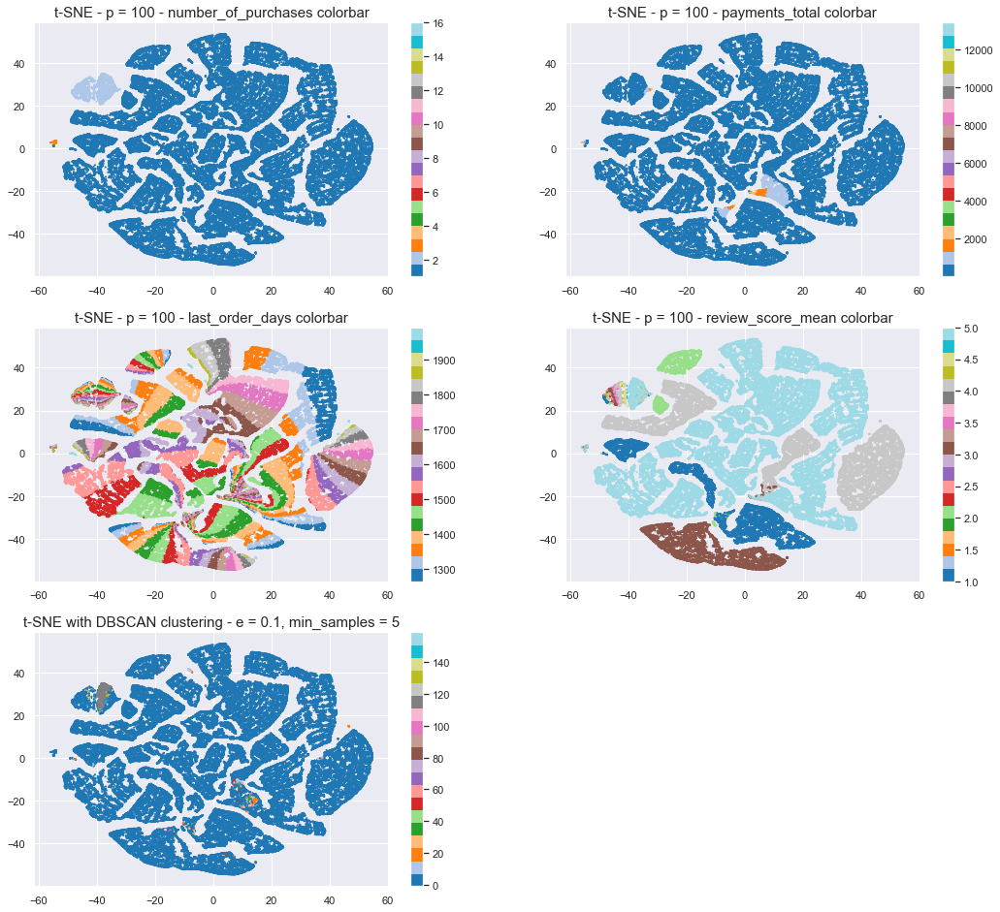

In [204]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE - p = 100 - '+ feat + ' colorbar', size = 15)
    plt.colorbar()

plt.title('t-SNE with DBSCAN clustering - e = 0.1, min_samples = 5', size = 15)
plt.show()

-> increasing numbers of clusters with those parameters (epsilon = 0.1 - min_samples = 5)

In [205]:
from sklearn.cluster import DBSCAN

labels_DBSCAN_035_5 = DBSCAN(eps = 0.35, min_samples = 5).fit_predict(X4_scaled)

data_4['labels_DBSCAN_035_5'] = labels_DBSCAN_035_5

list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_DBSCAN_035_5']

# Number of Clusters
N_clus = len(set(labels_DBSCAN_035_5)) - (1 if -1 in labels_DBSCAN_035_5 else 0)
print('Estimated no. of clusters: %d' % N_clus)

# Identify Noise
n_noise = list(labels_DBSCAN_035_5).count(-1)
print('Estimated no. of noise points: %d' % n_noise)

Estimated no. of clusters: 49
Estimated no. of noise points: 710


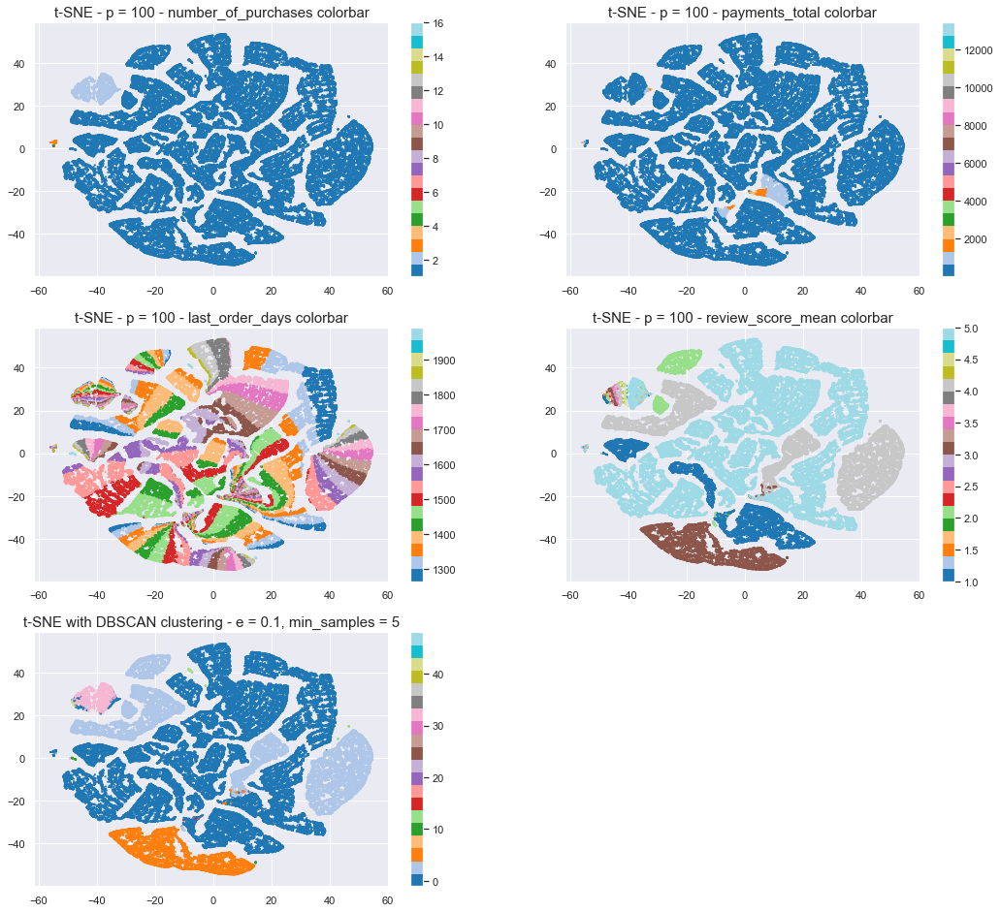

In [206]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE - p = 100 - '+ feat + ' colorbar', size = 15)
    plt.colorbar()

plt.title('t-SNE with DBSCAN clustering - e = 0.1, min_samples = 5', size = 15)
plt.show()

-> decreasing numbers of clusters with those parameters (epsilon = 0.35 - min_samples = 5)

In [207]:
from sklearn.cluster import DBSCAN

labels_DBSCAN_05_5 = DBSCAN(eps = 0.5, min_samples = 5).fit_predict(X4_scaled)

data_4['labels_DBSCAN_05_5'] = labels_DBSCAN_05_5

list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_DBSCAN_05_5']

# Number of Clusters
N_clus = len(set(labels_DBSCAN_05_5)) - (1 if -1 in labels_DBSCAN_05_5 else 0)
print('Estimated no. of clusters: %d' % N_clus)

# Identify Noise
n_noise = list(labels_DBSCAN_05_5).count(-1)
print('Estimated no. of noise points: %d' % n_noise)

Estimated no. of clusters: 25
Estimated no. of noise points: 414


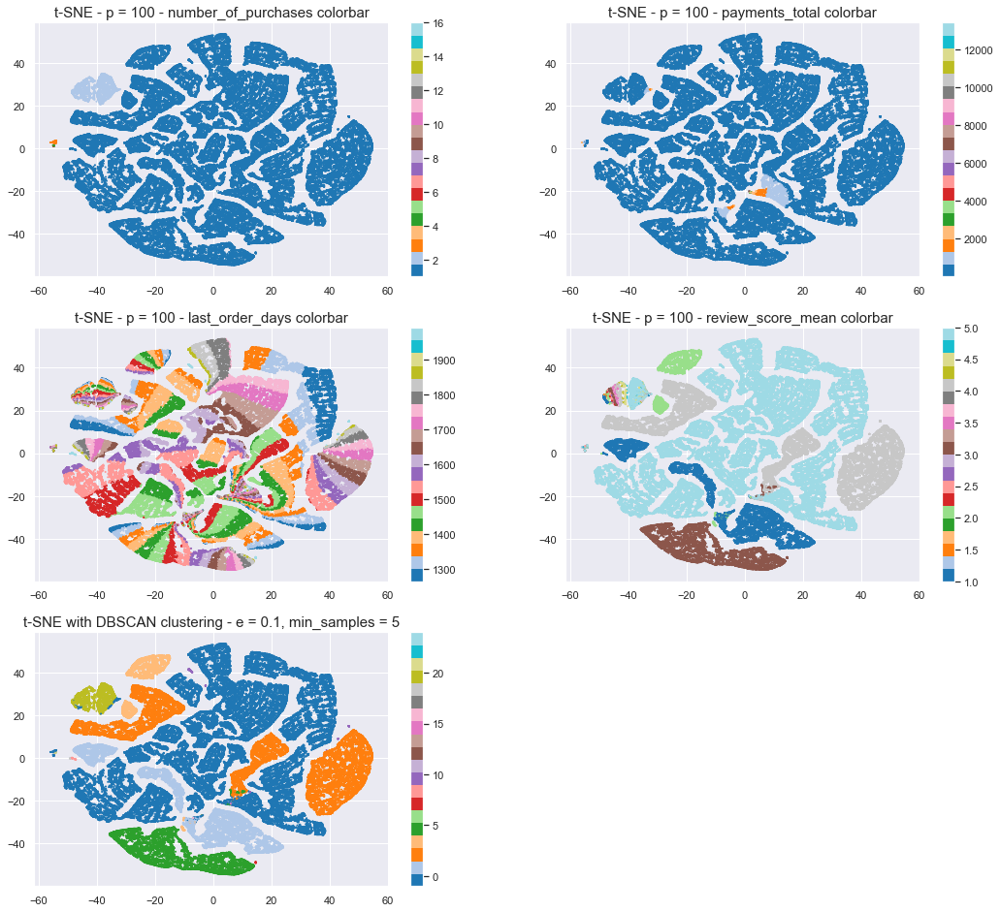

In [208]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE - p = 100 - '+ feat + ' colorbar', size = 15)
    plt.colorbar()

plt.title('t-SNE with DBSCAN clustering - e = 0.1, min_samples = 5', size = 15)
plt.show()

-> decreasing numbers of clusters with those parameters (epsilon = 0.5 - min_samples = 5)

In [209]:
from sklearn.cluster import DBSCAN

labels_DBSCAN_05_8 = DBSCAN(eps = 0.5, min_samples = 8).fit_predict(X4_scaled)

data_4['labels_DBSCAN_05_8'] = labels_DBSCAN_05_8

list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_DBSCAN_05_8']

# Number of Clusters
N_clus = len(set(labels_DBSCAN_05_8)) - (1 if -1 in labels_DBSCAN_05_8 else 0)
print('Estimated no. of clusters: %d' % N_clus)

# Identify Noise
n_noise = list(labels_DBSCAN_05_8).count(-1)
print('Estimated no. of noise points: %d' % n_noise)

Estimated no. of clusters: 18
Estimated no. of noise points: 559


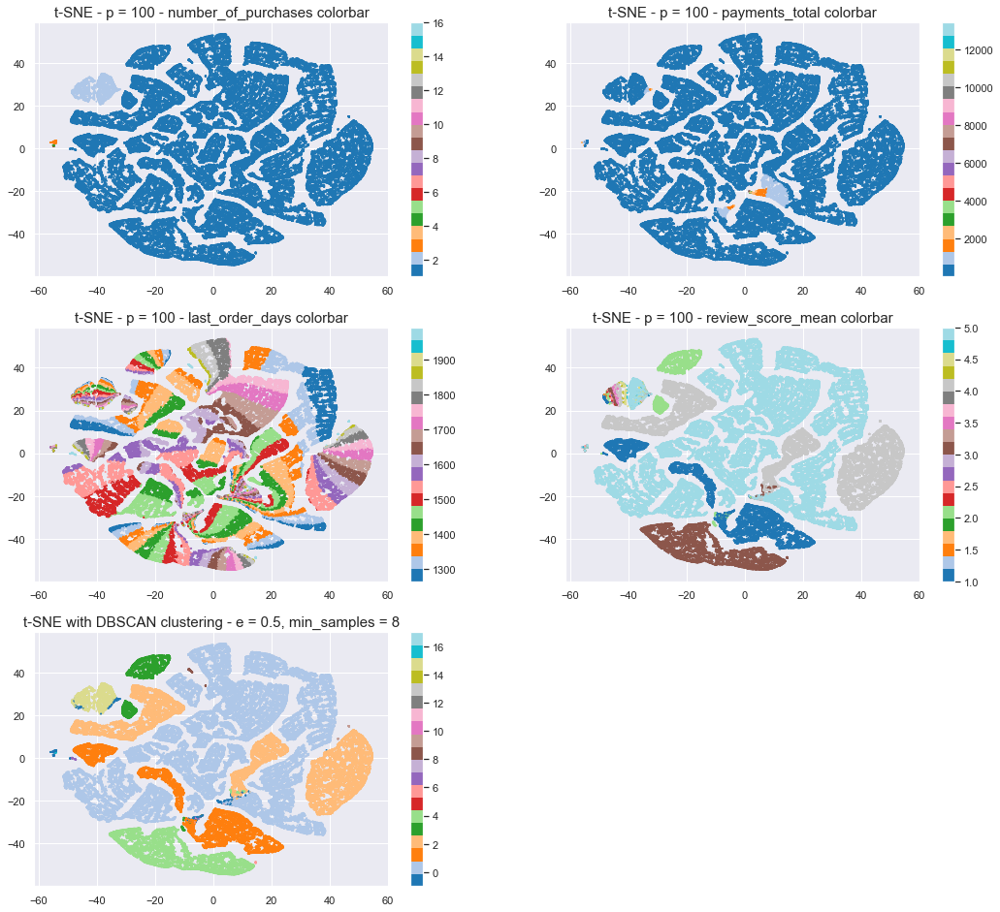

In [210]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE - p = 100 - '+ feat + ' colorbar', size = 15)
    plt.colorbar()

plt.title('t-SNE with DBSCAN clustering - e = 0.5, min_samples = 8', size = 15)
plt.show()

In [211]:
from sklearn.cluster import DBSCAN

labels_DBSCAN_06_5 = DBSCAN(eps = 0.6, min_samples = 5).fit_predict(X4_scaled)

data_4['labels_DBSCAN_06_5'] = labels_DBSCAN_06_5

list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_DBSCAN_06_5']

# Number of Clusters
N_clus = len(set(labels_DBSCAN_06_5)) - (1 if -1 in labels_DBSCAN_06_5 else 0)
print('Estimated no. of clusters: %d' % N_clus)

# Identify Noise
n_noise = list(labels_DBSCAN_06_5).count(-1)
print('Estimated no. of noise points: %d' % n_noise)

Estimated no. of clusters: 17
Estimated no. of noise points: 285


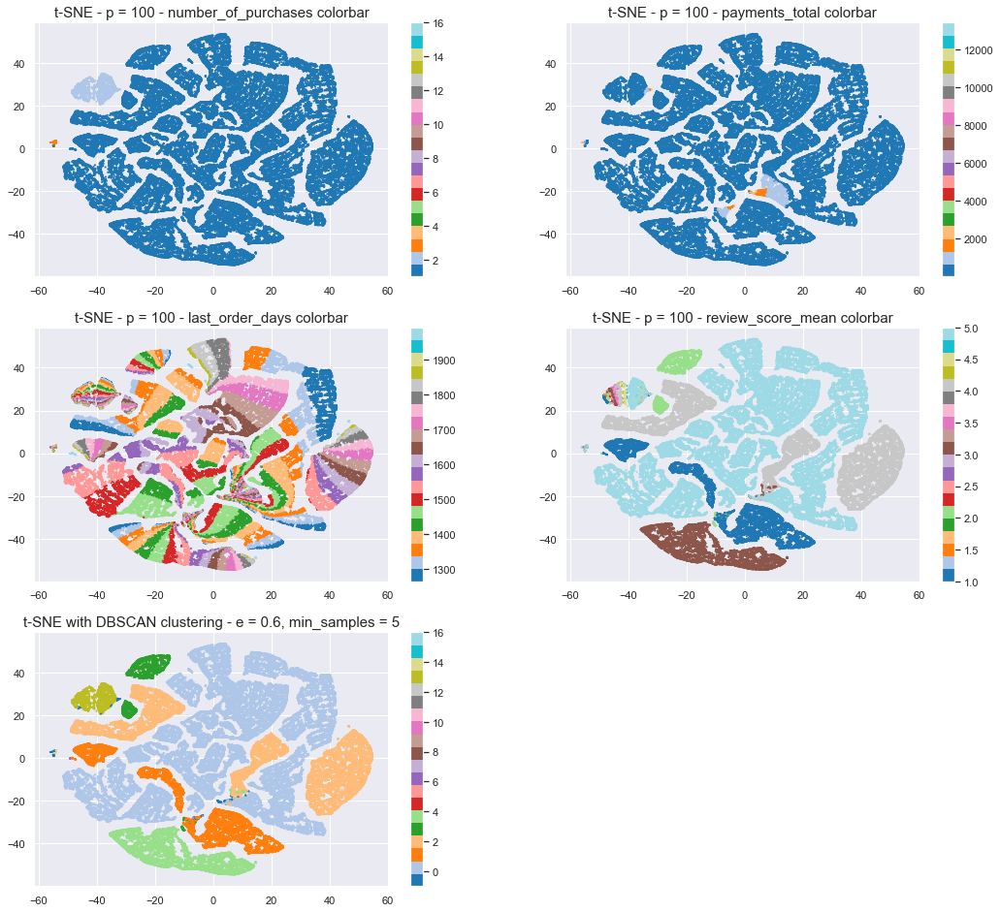

In [212]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE - p = 100 - '+ feat + ' colorbar', size = 15)
    plt.colorbar()

plt.title('t-SNE with DBSCAN clustering - e = 0.6, min_samples = 5', size = 15)
plt.show()

In [213]:
from sklearn.cluster import DBSCAN

labels_DBSCAN_07_5 = DBSCAN(eps = 0.7, min_samples = 5).fit_predict(X4_scaled)

data_4['labels_DBSCAN_07_5'] = labels_DBSCAN_07_5

list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_DBSCAN_07_5']

# Number of Clusters
N_clus = len(set(labels_DBSCAN_07_5)) - (1 if -1 in labels_DBSCAN_07_5 else 0)
print('Estimated no. of clusters: %d' % N_clus)

# Identify Noise
n_noise = list(labels_DBSCAN_07_5).count(-1)
print('Estimated no. of noise points: %d' % n_noise)

Estimated no. of clusters: 14
Estimated no. of noise points: 220


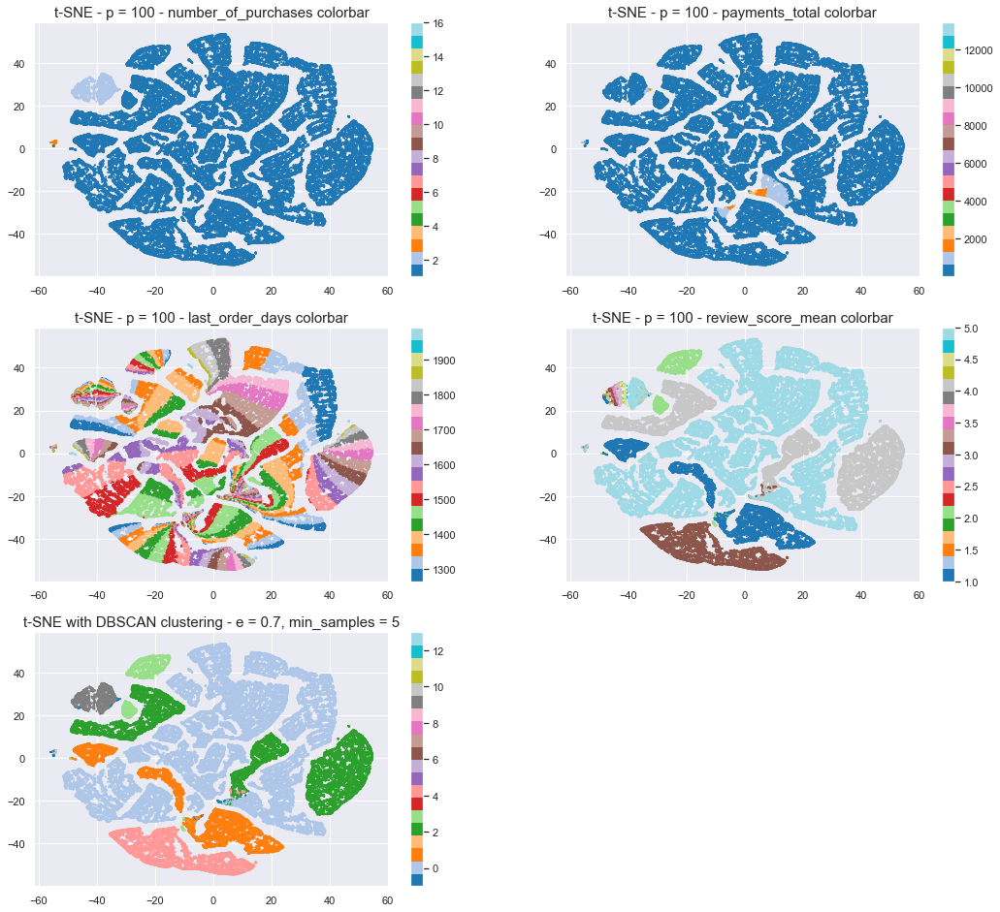

In [214]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE - p = 100 - '+ feat + ' colorbar', size = 15)
    plt.colorbar()

plt.title('t-SNE with DBSCAN clustering - e = 0.7, min_samples = 5', size = 15)
plt.show()

In [217]:
from sklearn.cluster import DBSCAN

labels_DBSCAN_075_5 = DBSCAN(eps = 0.75, min_samples = 5).fit_predict(X4_scaled)

data_4['labels_DBSCAN_075_5'] = labels_DBSCAN_075_5

list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_DBSCAN_075_5']

# Number of Clusters
N_clus = len(set(labels_DBSCAN_075_5)) - (1 if -1 in labels_DBSCAN_075_5 else 0)
print('Estimated no. of clusters: %d' % N_clus)

# Identify Noise
n_noise = list(labels_DBSCAN_075_5).count(-1)
print('Estimated no. of noise points: %d' % n_noise)

Estimated no. of clusters: 16
Estimated no. of noise points: 200


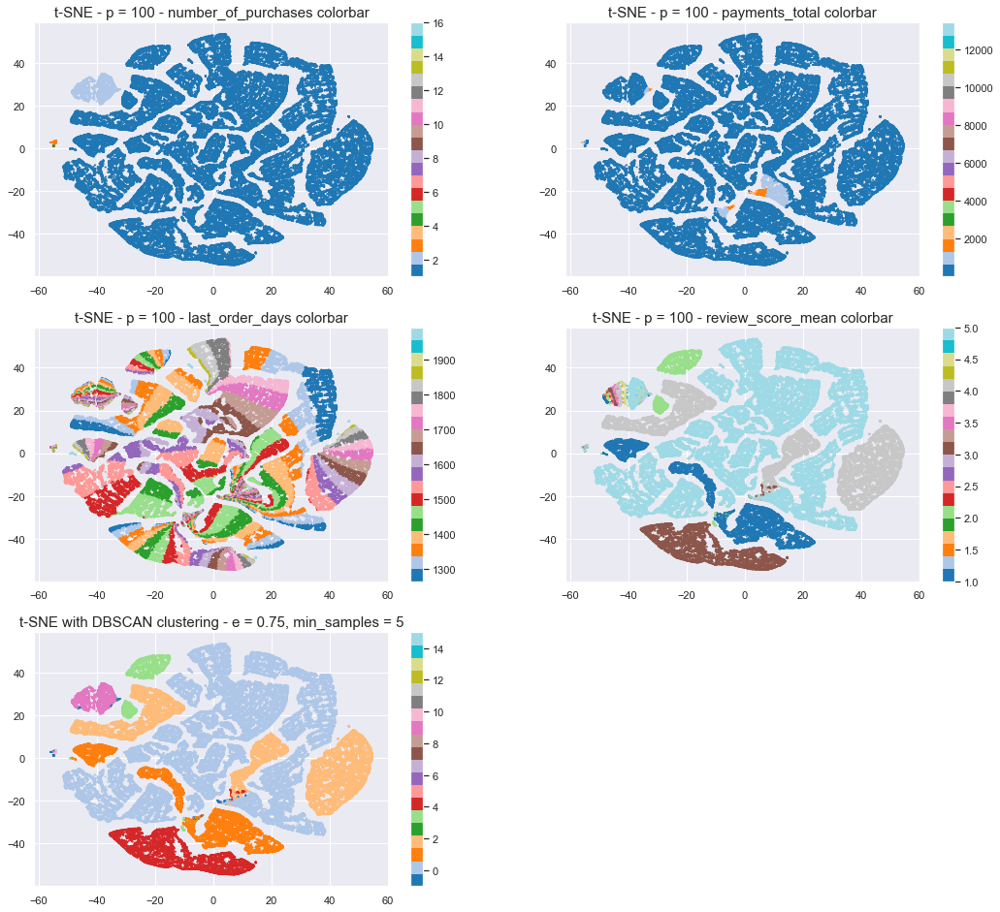

In [218]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE - p = 100 - '+ feat + ' colorbar', size = 15)
    plt.colorbar()

plt.title('t-SNE with DBSCAN clustering - e = 0.75, min_samples = 5', size = 15)
plt.show()

In [215]:
from sklearn.cluster import DBSCAN

labels_DBSCAN_08_5 = DBSCAN(eps = 0.8, min_samples = 5).fit_predict(X4_scaled)

data_4['labels_DBSCAN_08_5'] = labels_DBSCAN_08_5

list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_DBSCAN_08_5']

# Number of Clusters
N_clus = len(set(labels_DBSCAN_08_5)) - (1 if -1 in labels_DBSCAN_08_5 else 0)
print('Estimated no. of clusters: %d' % N_clus)

# Identify Noise
n_noise = list(labels_DBSCAN_08_5).count(-1)
print('Estimated no. of noise points: %d' % n_noise)

Estimated no. of clusters: 9
Estimated no. of noise points: 162


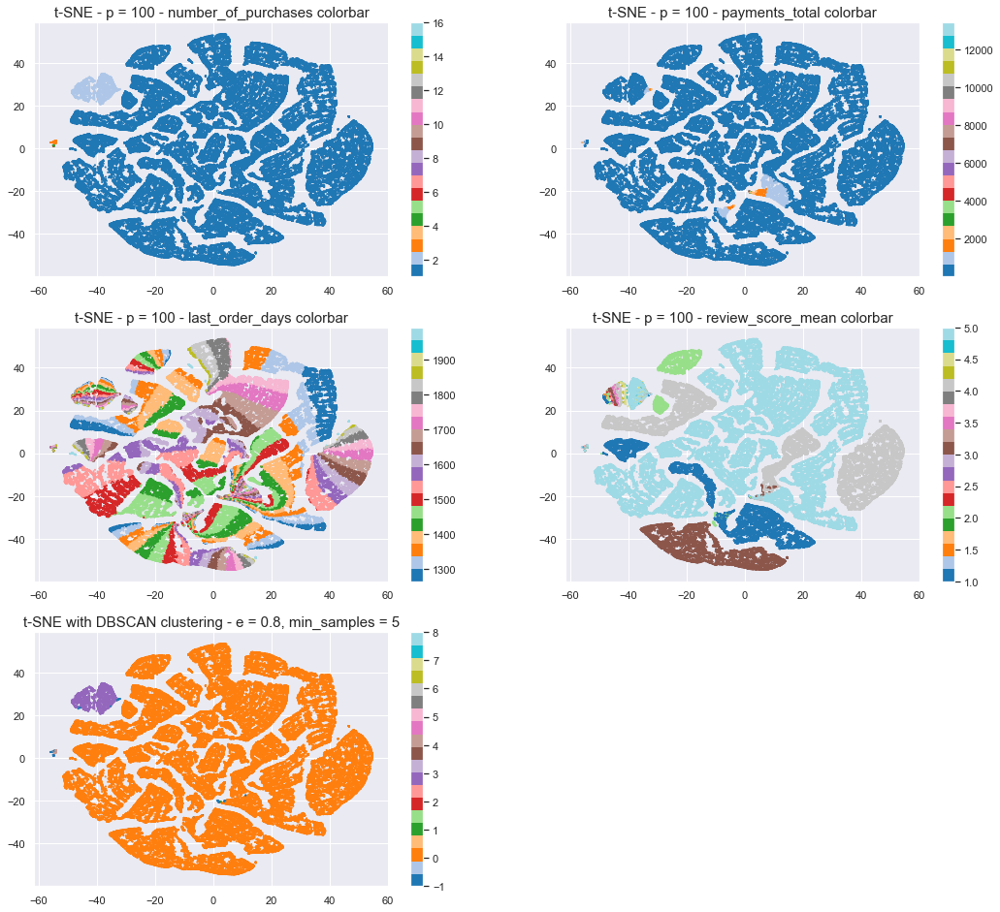

In [216]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE - p = 100 - '+ feat + ' colorbar', size = 15)
    plt.colorbar()

plt.title('t-SNE with DBSCAN clustering - e = 0.8, min_samples = 5', size = 15)
plt.show()

### Conclusion of DBSCAN Clustering

- best results : epsilon = 0.7 ou 0.75 ; min_samples = 5
- when epsilon increases : noise decreases and number of clusters decreseases
- when min_samples increases : number of clusters decreases but noise increases
- but too many points without any cluster (-1) and huge clusters vs tiny clusters

-> KMeans clustering seems to be the best option for this case

## 4) b) clustering With 5 features dataframe - orders, satisfaction and comments features :

### KMeans clustering

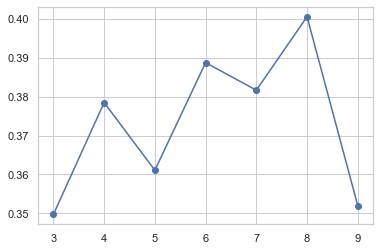

In [462]:
# Calculate silhouette scores for different number of clusters with Kmeans clustering
# on entire dataset
from sklearn.cluster import KMeans
from sklearn import metrics

silhouettes = []

for num_clusters in range(3, 11):
    cls = KMeans(n_clusters = num_clusters,
                 n_init = 10, 
                 init = 'k-means++')
    cls.fit(X5_scaled)
    silh = metrics.silhouette_score(X5_scaled, cls.labels_)
    silhouettes.append(silh)

plt.plot(range(3,11), silhouettes, marker = 'o');

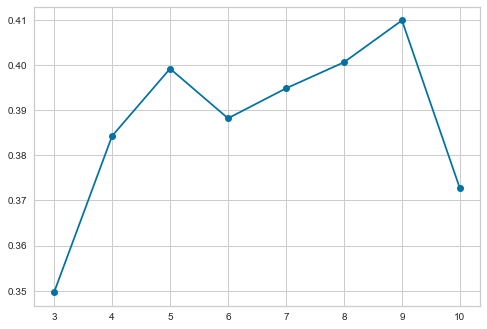

In [497]:
# Calculate silhouette scores for different number of clusters with Kmeans clustering
# on entire dataset
from sklearn.cluster import KMeans
from sklearn import metrics

silhouettes = []

for num_clusters in range(3, 11):
    cls = KMeans(n_clusters = num_clusters,
                 n_init = 10, 
                 init = 'k-means++')
    cls.fit(X5_scaled)
    silh = metrics.silhouette_score(X5_scaled, cls.labels_)
    silhouettes.append(silh)

plt.plot(range(3,11), silhouettes, marker = 'o');

In [463]:
pip install yellowbrick

Note: you may need to restart the kernel to use updated packages.


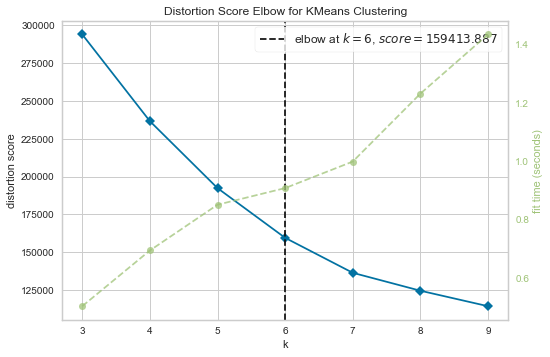

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [464]:
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(3,10))

visualizer.fit(X5_scaled)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data

In [468]:
# Run local implementation of kmeans
km = KMeans(n_clusters = 6, 
            max_iter = 300,
            n_init = 10,
            init = 'k-means++')
km.fit(X5_scaled)

KMeans(n_clusters=6)

In [469]:
labels_k_means = km.labels_
data_5['labels_kmeans'] = labels_k_means

In [ ]:
plt.figure(figsize = (15,10))
plt.subplots_adjust(top = 1.5)

for index, p in enumerate([1, 10, 25, 50, 75, 100]):
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results['tsne1'], 
                tsne_results['tsne2'], 
                c = data_5.get('labels_kmeans'), 
                s = 1, 
                cmap = 'tab20')
    plt.title('Perplexity = '+ str(p))
    plt.colorbar()

plt.show()

In [475]:
list_feat_5

['number_of_purchases',
 'payments_total',
 'last_order_days',
 'review_score_mean',
 'percentage_of_review_comments']

In [476]:
list_feat_5_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'percentage_of_review_comments',
                         'labels_kmeans']

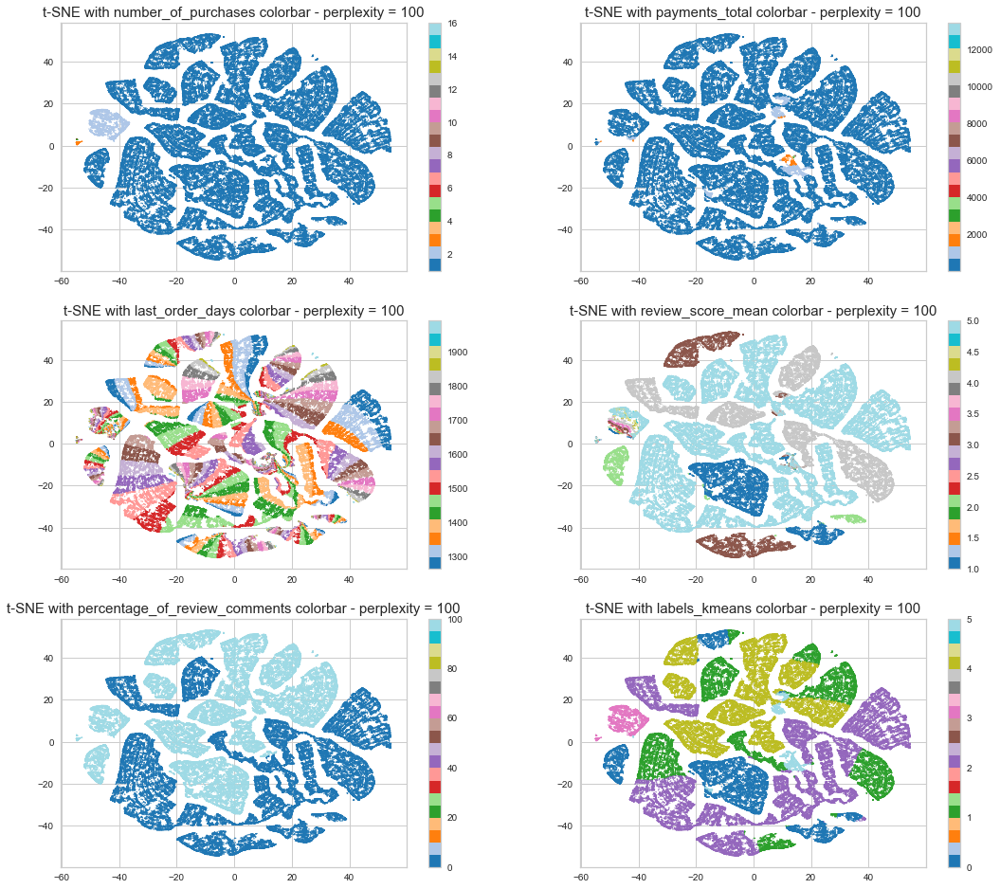

In [478]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_5_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_5.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - perplexity = 100', size = 15)
    plt.colorbar()

plt.show()

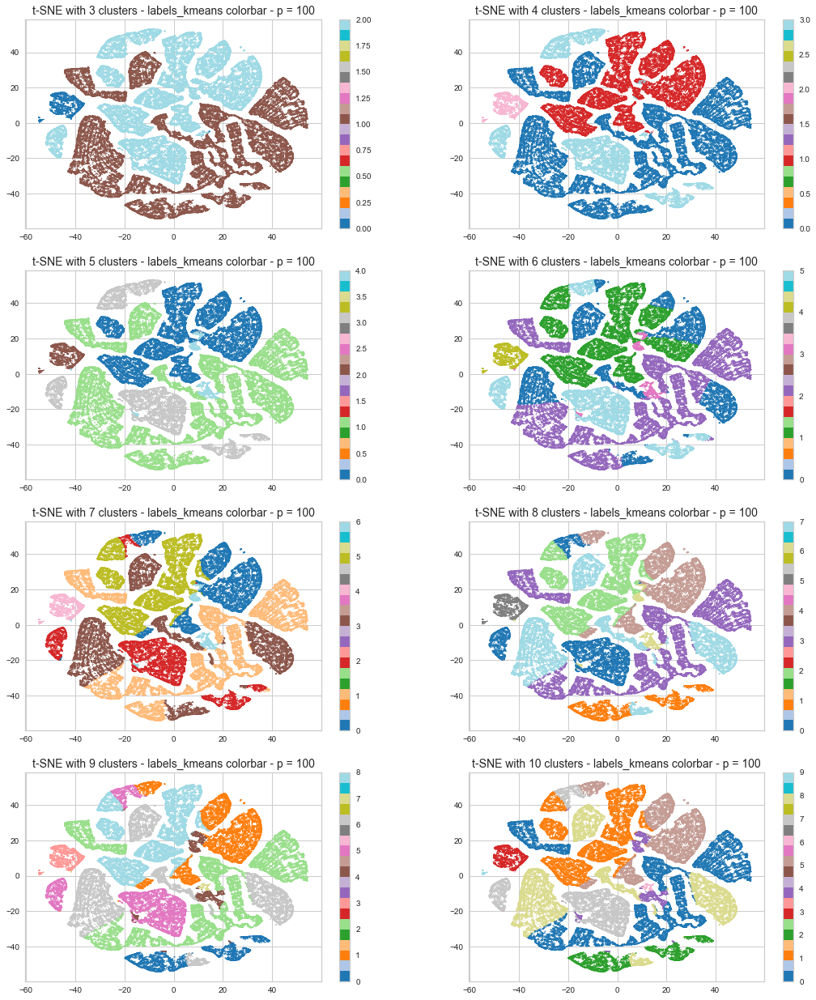

In [487]:
plt.figure(figsize = (18, 12))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, num_clusters in enumerate(range(3, 11)):
    km = KMeans(n_clusters = num_clusters,
                 max_iter = 300,
                 n_init = 10, 
                 init = 'k-means++')
    km.fit(X5_scaled)
    labels_k_means = km.labels_
    data_5['labels_kmeans'] = labels_k_means
    plt.subplot(4,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_5.get('labels_kmeans'), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ str(num_clusters) + ' clusters - labels_kmeans colorbar - p = 100', size = 14)
    plt.colorbar()

plt.show()

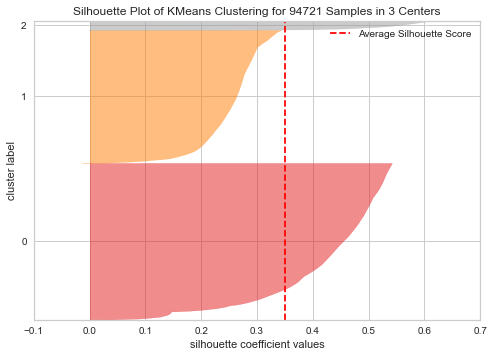

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 94721 Samples in 3 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [491]:
# Instantiate the clustering model and visualizer 
model = KMeans(n_clusters = 3,
               max_iter = 300,
               n_init = 10,
               init = 'k-means++')
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X5_scaled)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data
print('kmeans - 3 clusters - silhouette_score = ', visualizer.silhouette_score_)

In [493]:
visualizer.silhouette_score_

0.349684978133537

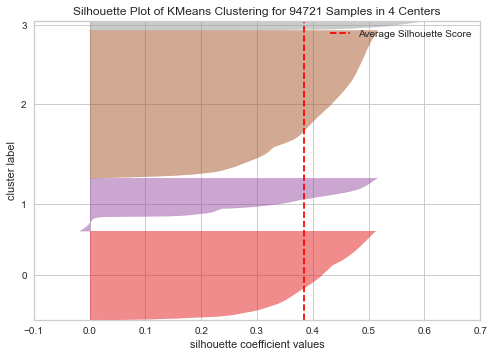

kmeans - 4 clusters - silhouette_score =  0.38426423700568674


In [494]:
# Instantiate the clustering model and visualizer 
model = KMeans(n_clusters = 4,
               max_iter = 300,
               n_init = 10,
               init = 'k-means++')
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X5_scaled)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data
print('kmeans - 4 clusters - silhouette_score = ', visualizer.silhouette_score_)

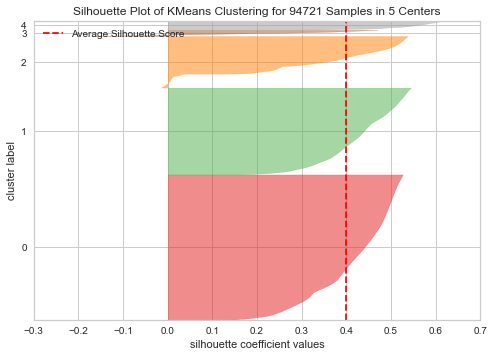

kmeans - 5 clusters - silhouette_score =  0.3991718767250251


In [495]:
# Instantiate the clustering model and visualizer 
model = KMeans(n_clusters = 5,
               max_iter = 300,
               n_init = 10,
               init = 'k-means++')
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X5_scaled)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data
print('kmeans - 5 clusters - silhouette_score = ', visualizer.silhouette_score_)

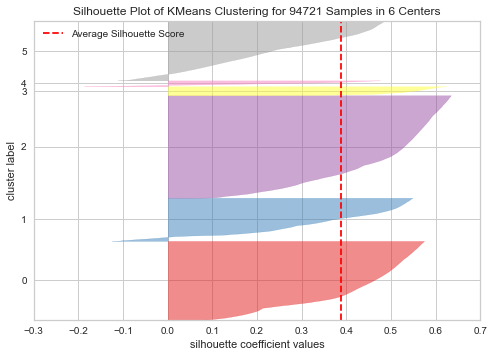

kmeans - 6 clusters - silhouette_score =  0.38877335271987995


In [496]:
# Instantiate the clustering model and visualizer 
model = KMeans(n_clusters = 6,
               max_iter = 300,
               n_init = 10,
               init = 'k-means++')
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X5_scaled)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data
print('kmeans - 6 clusters - silhouette_score = ', visualizer.silhouette_score_)

# 5) Observation and analysis of the 5 KMeans Clusters

In [210]:
data_4_5_clusters = data_4[['number_of_purchases',
                          'payments_total',
                          'last_order_days',
                          'review_score_mean',
                          'labels_kmeans_5']]
data_4_5_clusters

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_5
Customer,,,,,
8c446b198f0c92d5db58d3c8eacd3a11,1,196.80,1274,5.0,4
0c7f5da7d9d33d16ddc25dfafcc513ce,1,89.00,1289,5.0,4
8b27e23ca14dc7d4d8e429abda30b5fb,1,99.80,1292,5.0,4
3c068da825c04776514f05089b83ef6b,1,99.80,1296,5.0,4
3cc1026f5863d3b5fc44bd92bad50cee,1,94.60,1306,5.0,4
...,...,...,...,...,...
2e15add79c76241beffe812a24ad3a31,1,129.80,1965,1.0,0
a9530b74fe56ca4be9e5f2c7e7c4175a,1,119.80,1965,1.0,0
f176923a0a4ab546c7287791ccb82193,1,47.80,1965,5.0,3


In [211]:
data_4_cluster_0 = data_4_5_clusters.loc[data_4_5_clusters['labels_kmeans_5'] == 0]
data_4_cluster_1 = data_4_5_clusters.loc[data_4_5_clusters['labels_kmeans_5'] == 1]
data_4_cluster_2 = data_4_5_clusters.loc[data_4_5_clusters['labels_kmeans_5'] == 2]
data_4_cluster_3 = data_4_5_clusters.loc[data_4_5_clusters['labels_kmeans_5'] == 3]
data_4_cluster_4 = data_4_5_clusters.loc[data_4_5_clusters['labels_kmeans_5'] == 4]

In [212]:
X4_0 = data_4_cluster_0[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_1 = data_4_cluster_1[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_2 = data_4_cluster_2[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_3 = data_4_cluster_3[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_4 = data_4_cluster_4[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values

In [213]:
print("shape X4_0 : ", X4_0.shape)
print("shape X4_1 : ", X4_1.shape)
print("shape X4_2 : ", X4_2.shape)
print("shape X4_3 : ", X4_3.shape)
print("shape X4_4 : ", X4_4.shape)

shape X4_0 :  (16455, 4)
shape X4_1 :  (2839, 4)
shape X4_2 :  (2013, 4)
shape X4_3 :  (31612, 4)
shape X4_4 :  (41802, 4)


## 5) a) Cluster #0

In [214]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_0)
X4_0_scaled = std_scale.transform(X4_0)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_0 = tsne.fit_transform(X4_0_scaled)
tsne_result_p100_0.shape

(16455, 2)

In [217]:
list_feat_4 = ['number_of_purchases',
               'payments_total',
               'last_order_days',
               'review_score_mean']

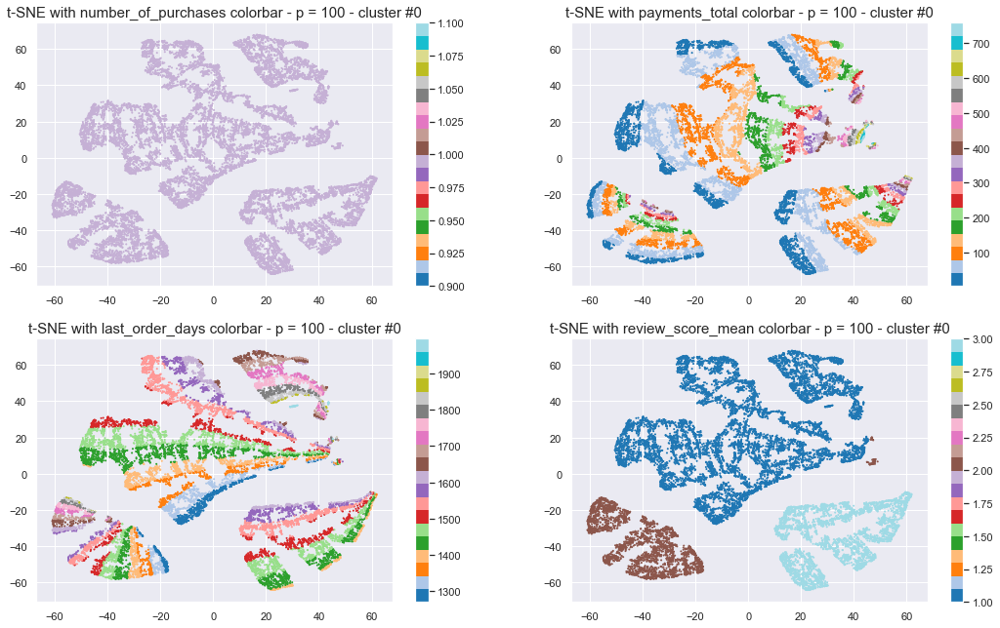

In [218]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_0 = pd.DataFrame(tsne_result_p100_0, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_0['tsne1'], 
                tsne_results_p100_0['tsne2'], 
                c = data_4_cluster_0[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #0', size = 15)
    plt.colorbar()

plt.show()

In [219]:
data_4_cluster_0.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_5
count,16455.0,16455.000000,16455.000000,16455.000000,16455.0
mean,1.0,127.879465,1510.294075,1.623154,0.0
std,0.0,120.104402,131.225021,0.828205,0.0
min,1.0,3.540000,1271.000000,1.000000,0.0
25%,1.0,49.000000,1428.000000,1.000000,0.0
50%,1.0,89.990000,1490.000000,1.000000,0.0
75%,1.0,159.900000,1569.000000,2.000000,0.0
max,1.0,759.000000,1995.000000,3.000000,0.0


In [232]:
# Create a recap dataframe

cluster_0 = {'cluster' : ['0'],
             'number_of_customers' : [len(X4_0)],
             'number_of_purchases' : ['1'], 
             'payments_total' : ['3.54 - 759.00'],
             'last_order_days' : ['1271 - 1995'],
             'review_score_mean' : ['1 - 3']}

recap_clusters = pd.DataFrame(cluster_0)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,16455,1,3.54 - 759.00,1271 - 1995,1 - 3


## 5) b) Cluster #1

In [225]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_1)
X4_1_scaled = std_scale.transform(X4_1)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_1 = tsne.fit_transform(X4_1_scaled)
tsne_result_p100_1.shape

(2839, 2)

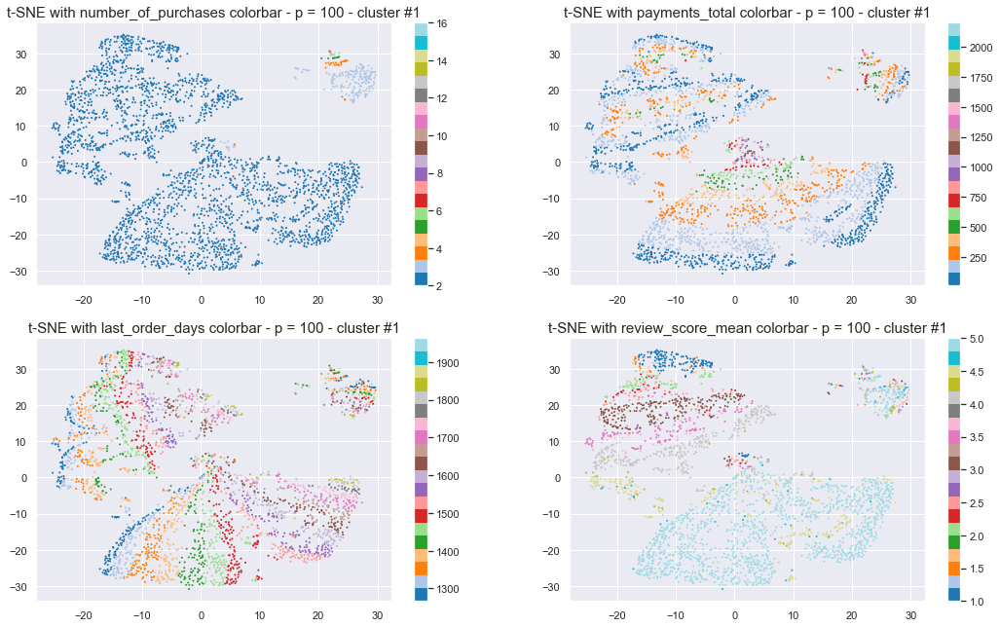

In [226]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_1 = pd.DataFrame(tsne_result_p100_1, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_1['tsne1'], 
                tsne_results_p100_1['tsne2'], 
                c = data_4_cluster_1[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #1', size = 15)
    plt.colorbar()

plt.show()

In [227]:
data_4_cluster_1.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_5
count,2839.000000,2839.000000,2839.000000,2839.000000,2839.0
mean,2.114477,242.330423,1492.559704,4.139661,1.0
std,0.511253,208.480824,144.937494,1.142248,0.0
min,2.000000,11.980000,1267.000000,1.000000,1.0
25%,2.000000,111.895000,1376.000000,3.500000,1.0
50%,2.000000,179.900000,1472.000000,4.500000,1.0
75%,2.000000,299.800000,1592.000000,5.000000,1.0
max,16.000000,2200.000000,1963.000000,5.000000,1.0


In [233]:
# Create a recap dataframe

cluster_0_1 = {'cluster' : ['0', '1'],
               'number_of_customers' : [len(X4_0), len(X4_1)],
             'number_of_purchases' : ['1', '2 - 16'], 
             'payments_total' : ['3.54 - 759.00', '11.98 - 2200'],
             'last_order_days' : ['1271 - 1995', '1267 - 1963'],
             'review_score_mean' : ['1 - 3', '1 - 5']}

recap_clusters = pd.DataFrame(cluster_0_1)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,16455,1,3.54 - 759.00,1271 - 1995,1 - 3
1,1,2839,2 - 16,11.98 - 2200,1267 - 1963,1 - 5


## 5) c) Cluster #2

In [234]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_2)
X4_2_scaled = std_scale.transform(X4_2)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_2 = tsne.fit_transform(X4_2_scaled)
tsne_result_p100_2.shape

(2013, 2)

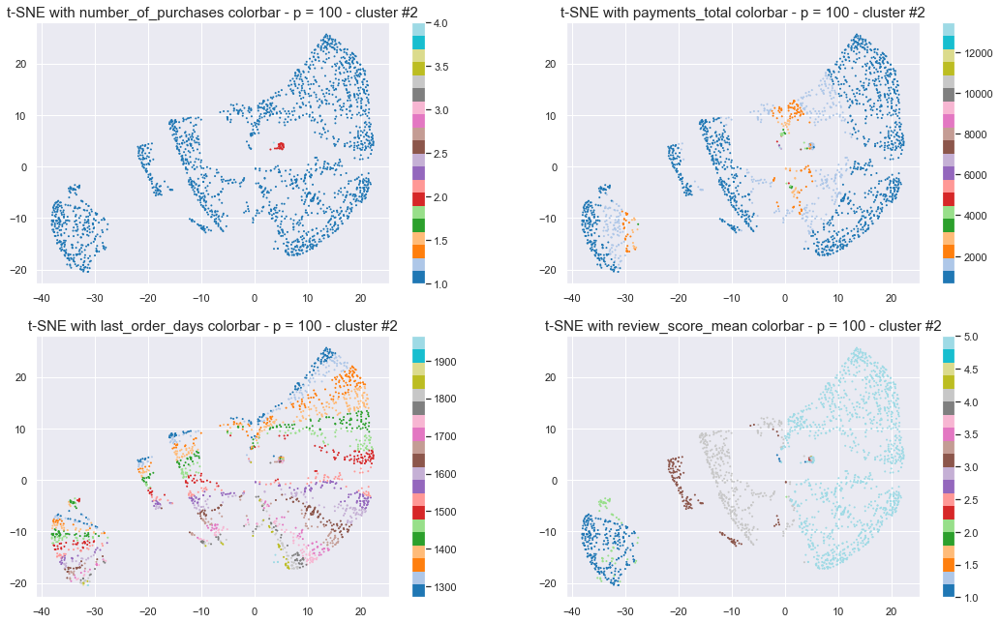

In [235]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_2 = pd.DataFrame(tsne_result_p100_2, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_2['tsne1'], 
                tsne_results_p100_2['tsne2'], 
                c = data_4_cluster_2[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #2', size = 15)
    plt.colorbar()

plt.show()

In [236]:
data_4_cluster_2.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_5
count,2013.000000,2013.000000,2013.000000,2013.000000,2013.0
mean,1.015897,1198.262350,1510.767014,4.026956,2.0
std,0.136506,685.109748,154.254891,1.418440,0.0
min,1.000000,639.920000,1272.000000,1.000000,2.0
25%,1.000000,799.000000,1382.000000,4.000000,2.0
50%,1.000000,987.000000,1491.000000,5.000000,2.0
75%,1.000000,1359.000000,1627.000000,5.000000,2.0
max,4.000000,13440.000000,1965.000000,5.000000,2.0


In [237]:
# Create a recap dataframe

cluster_0_1_2 = {'cluster' : ['0', '1', '2'],
               'number_of_customers' : [len(X4_0), len(X4_1), len(X4_2)],
             'number_of_purchases' : ['1', '2 - 16', '1 - 4'], 
             'payments_total' : ['3.54 - 759.00', '11.98 - 2200', '639.92 - 13440'],
             'last_order_days' : ['1271 - 1995', '1267 - 1963', '1272 - 1965'],
             'review_score_mean' : ['1 - 3', '1 - 5', '1 - 5']}

recap_clusters = pd.DataFrame(cluster_0_1_2)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,16455,1,3.54 - 759.00,1271 - 1995,1 - 3
1,1,2839,2 - 16,11.98 - 2200,1267 - 1963,1 - 5
2,2,2013,1 - 4,639.92 - 13440,1272 - 1965,1 - 5


## 5) d) Cluster #3

In [238]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_3)
X4_3_scaled = std_scale.transform(X4_3)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_3 = tsne.fit_transform(X4_3_scaled)
tsne_result_p100_3.shape

(31612, 2)

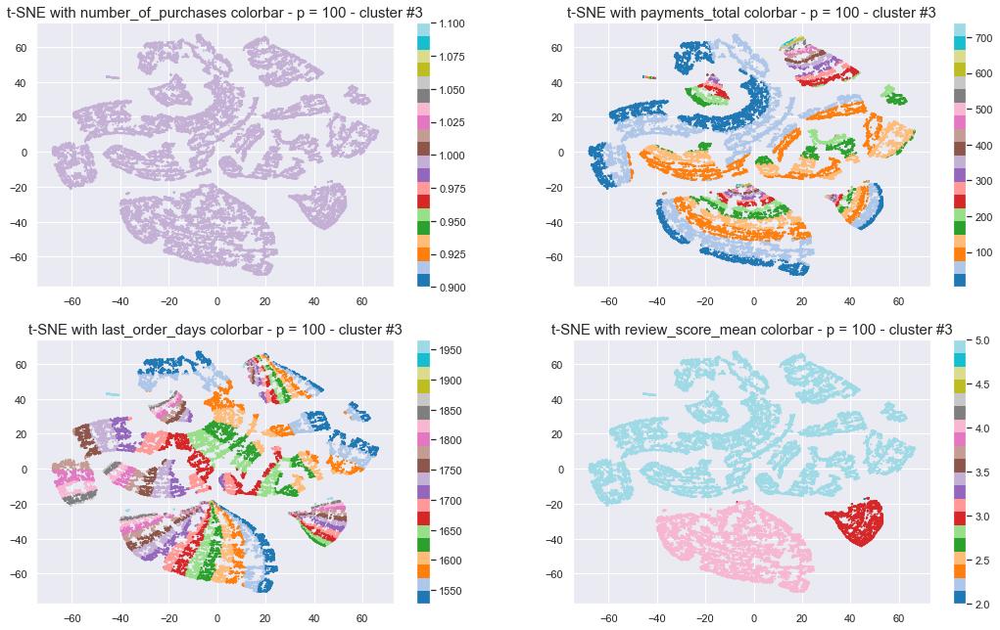

In [239]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_3 = pd.DataFrame(tsne_result_p100_3, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_3['tsne1'], 
                tsne_results_p100_3['tsne2'], 
                c = data_4_cluster_3[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #3', size = 15)
    plt.colorbar()

plt.show()

In [240]:
data_4_cluster_3.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_5
count,31612.0,31612.000000,31612.000000,31612.000000,31612.0
mean,1.0,113.543429,1664.294951,4.633241,3.0
std,0.0,106.421163,95.207648,0.594912,0.0
min,1.0,2.290000,1527.000000,2.000000,3.0
25%,1.0,45.000000,1580.000000,4.000000,3.0
50%,1.0,79.990000,1654.000000,5.000000,3.0
75%,1.0,142.000000,1736.000000,5.000000,3.0
max,1.0,739.980000,1966.000000,5.000000,3.0


In [241]:
# Create a recap dataframe

cluster_0_1_2_3 = {'cluster' : ['0', '1', '2', '3'],
               'number_of_customers' : [len(X4_0), len(X4_1), len(X4_2), len(X4_3)],
             'number_of_purchases' : ['1', '2 - 16', '1 - 4', '1'], 
             'payments_total' : ['3.54 - 759.00', '11.98 - 2200', '639.92 - 13440', '2.29 - 739.98'],
             'last_order_days' : ['1271 - 1995', '1267 - 1963', '1272 - 1965', '1527 - 1966'],
             'review_score_mean' : ['1 - 3', '1 - 5', '1 - 5', '2 << 3 < 4 < 5']}

recap_clusters = pd.DataFrame(cluster_0_1_2_3)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,16455,1,3.54 - 759.00,1271 - 1995,1 - 3
1,1,2839,2 - 16,11.98 - 2200,1267 - 1963,1 - 5
2,2,2013,1 - 4,639.92 - 13440,1272 - 1965,1 - 5
3,3,31612,1,2.29 - 739.98,1527 - 1966,2 << 3 < 4 < 5


## 5) e) Cluster #4

In [242]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_4)
X4_4_scaled = std_scale.transform(X4_4)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_4 = tsne.fit_transform(X4_4_scaled)
tsne_result_p100_4.shape

(41802, 2)

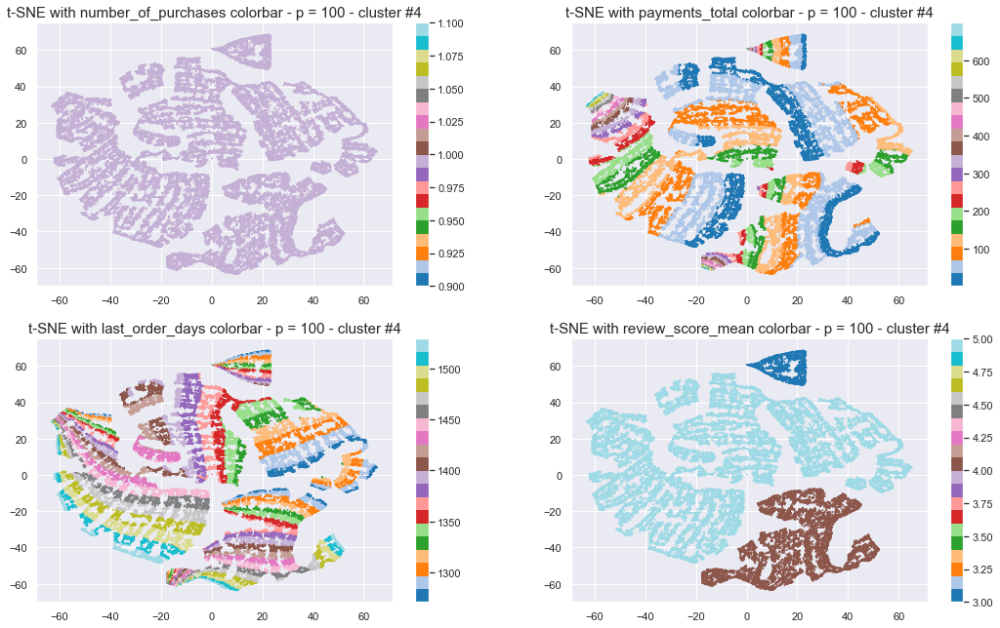

In [243]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_4 = pd.DataFrame(tsne_result_p100_4, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_4['tsne1'], 
                tsne_results_p100_4['tsne2'], 
                c = data_4_cluster_4[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #4', size = 15)
    plt.colorbar()

plt.show()

In [244]:
data_4_cluster_4.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_5
count,41802.0,41802.000000,41802.000000,41802.000000,41802.0
mean,1.0,111.795496,1393.180422,4.676905,4.0
std,0.0,101.920826,72.703686,0.553933,0.0
min,1.0,0.850000,1271.000000,3.000000,4.0
25%,1.0,44.900000,1330.000000,4.000000,4.0
50%,1.0,81.650000,1390.000000,5.000000,4.0
75%,1.0,141.600000,1455.000000,5.000000,4.0
max,1.0,699.400000,1529.000000,5.000000,4.0


In [246]:
# Create a recap dataframe

cluster_0_1_2_3_4 = {'cluster' : ['0', '1', '2', '3', '4'],
               'number_of_customers' : [len(X4_0), len(X4_1), len(X4_2), len(X4_3), len(X4_4)],
             'number_of_purchases' : ['1', '2 - 16', '1 - 4', '1', '1'], 
             'payments_total' : ['3.54 - 759.00', '11.98 - 2200', '639.92 - 13440', '2.29 - 739.98', '0.85 - 699.40'],
             'last_order_days' : ['1271 - 1995', '1267 - 1963', '1272 - 1965', '1527 - 1966', '1271 - 1529'],
             'review_score_mean' : ['1 - 3', '1 - 5', '1 - 5', '2 << 3 < 4 < 5', '3 < 4 < 5']}

recap_clusters = pd.DataFrame(cluster_0_1_2_3_4)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,16455,1,3.54 - 759.00,1271 - 1995,1 - 3
1,1,2839,2 - 16,11.98 - 2200,1267 - 1963,1 - 5
2,2,2013,1 - 4,639.92 - 13440,1272 - 1965,1 - 5
3,3,31612,1,2.29 - 739.98,1527 - 1966,2 << 3 < 4 < 5
4,4,41802,1,0.85 - 699.40,1271 - 1529,3 < 4 < 5


In [247]:
recap_clusters = recap_clusters.assign(description = ['1 purchase - low to medium review_score_mean',
                                                     'several purchases - low number of customers',
                                                     'high payments_total - low number of customers',
                                                     '1 purchase - medium to high review score - did not order recently - high number of customers',
                                                     '1 purchase - medium to high review score - ordered recently - high number of customers'])

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean,description
0,0,16455,1,3.54 - 759.00,1271 - 1995,1 - 3,1 purchase - low to medium review_score_mean
1,1,2839,2 - 16,11.98 - 2200,1267 - 1963,1 - 5,several purchases - low number of customers
2,2,2013,1 - 4,639.92 - 13440,1272 - 1965,1 - 5,high payments_total - low number of customers
3,3,31612,1,2.29 - 739.98,1527 - 1966,2 << 3 < 4 < 5,1 purchase - medium to high review score - did not order recently - high number of customers
4,4,41802,1,0.85 - 699.40,1271 - 1529,3 < 4 < 5,1 purchase - medium to high review score - ordered recently - high number of customers


# 6) Observation and analysis of the 3 KMeans Clusters

In [248]:
from sklearn.cluster import KMeans
from sklearn import metrics

# Run local implementation of kmeans with 3 clusters
km = KMeans(n_clusters = 3, 
            max_iter = 100,
            n_init = 10,
            init = 'k-means++')
km.fit(X4_scaled)

labels_kmeans_3_clusters = km.labels_
data_4['labels_kmeans_3'] = labels_kmeans_3_clusters

In [250]:
list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_kmeans_3']

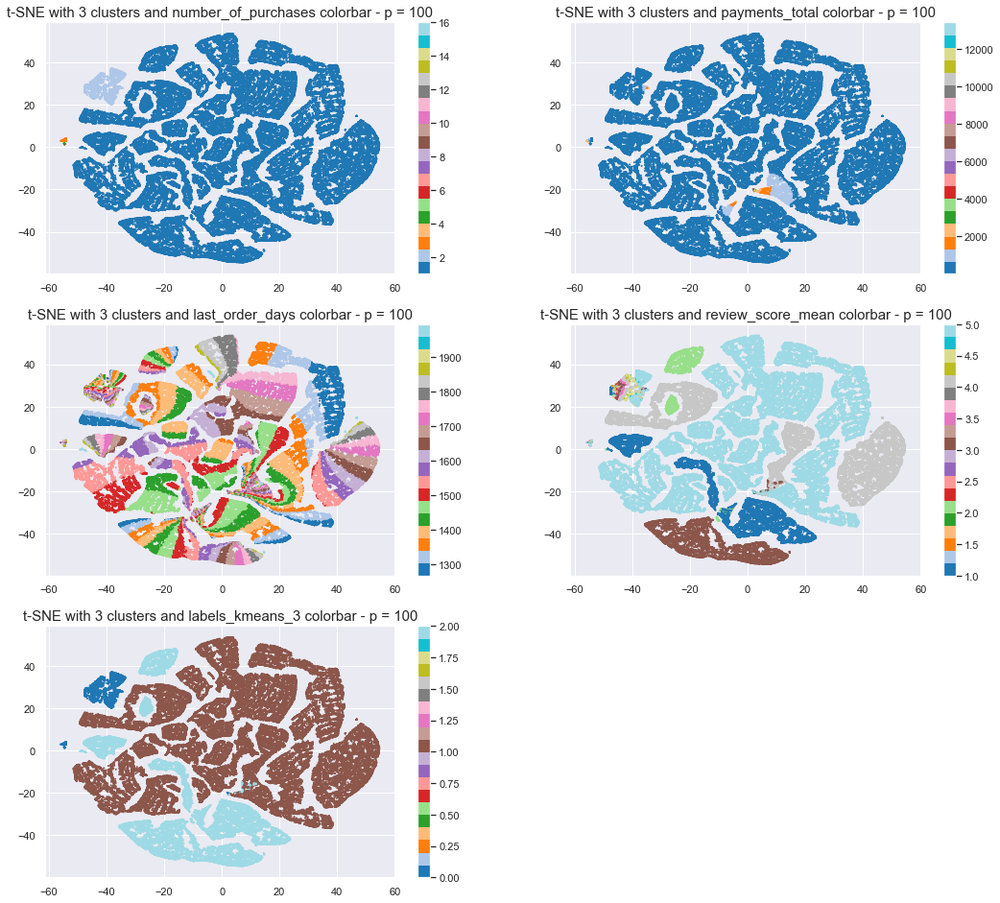

In [251]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with 3 clusters and '+ feat + ' colorbar - p = 100', size = 15)
    plt.colorbar()

plt.show()

In [252]:
data_4_3_clusters = data_4[['number_of_purchases',
                          'payments_total',
                          'last_order_days',
                          'review_score_mean',
                          'labels_kmeans_3']]
data_4_3_clusters

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_3
Customer,,,,,
8c446b198f0c92d5db58d3c8eacd3a11,1,196.80,1274,5.0,1
0c7f5da7d9d33d16ddc25dfafcc513ce,1,89.00,1289,5.0,1
8b27e23ca14dc7d4d8e429abda30b5fb,1,99.80,1292,5.0,1
3c068da825c04776514f05089b83ef6b,1,99.80,1296,5.0,1
3cc1026f5863d3b5fc44bd92bad50cee,1,94.60,1306,5.0,1
...,...,...,...,...,...
2e15add79c76241beffe812a24ad3a31,1,129.80,1965,1.0,2
a9530b74fe56ca4be9e5f2c7e7c4175a,1,119.80,1965,1.0,2
f176923a0a4ab546c7287791ccb82193,1,47.80,1965,5.0,1


In [253]:
data_4_cluster_3_0 = data_4_3_clusters.loc[data_4_3_clusters['labels_kmeans_3'] == 0]
data_4_cluster_3_1 = data_4_3_clusters.loc[data_4_3_clusters['labels_kmeans_3'] == 1]
data_4_cluster_3_2 = data_4_3_clusters.loc[data_4_3_clusters['labels_kmeans_3'] == 2]

In [254]:
X4_3_0 = data_4_cluster_3_0[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_3_1 = data_4_cluster_3_1[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_3_2 = data_4_cluster_3_2[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values

In [255]:
print("shape X4_0 : ", X4_3_0.shape)
print("shape X4_1 : ", X4_3_1.shape)
print("shape X4_2 : ", X4_3_2.shape)

shape X4_0 :  (2873, 4)
shape X4_1 :  (71166, 4)
shape X4_2 :  (20682, 4)


## 6) a) Cluster #0

In [256]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_3_0)
X4_3_0_scaled = std_scale.transform(X4_3_0)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_3_0 = tsne.fit_transform(X4_3_0_scaled)
tsne_result_p100_3_0.shape

(2873, 2)

In [258]:
list_feat_4 = ['number_of_purchases',
               'payments_total',
               'last_order_days',
               'review_score_mean']

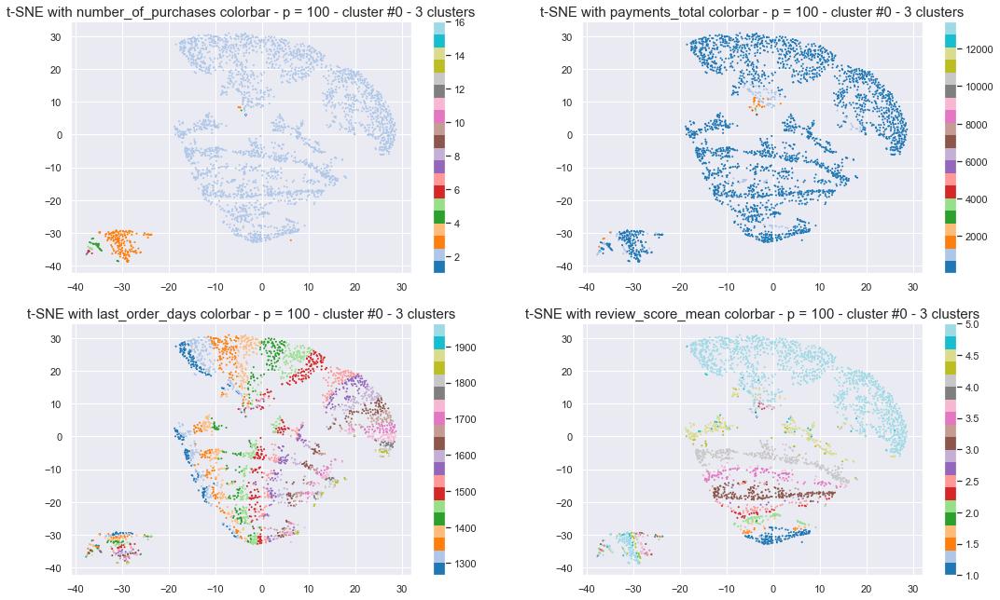

In [259]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_3_0 = pd.DataFrame(tsne_result_p100_3_0, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_3_0['tsne1'], 
                tsne_results_p100_3_0['tsne2'], 
                c = data_4_cluster_3_0[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #0 - 3 clusters', size = 15)
    plt.colorbar()

plt.show()

In [260]:
data_4_cluster_3_0.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_3
count,2873.000000,2873.000000,2873.000000,2873.000000,2873.0
mean,2.112426,272.984943,1492.767490,4.139144,0.0
std,0.511254,446.212135,145.101651,1.143763,0.0
min,1.000000,11.980000,1267.000000,1.000000,0.0
25%,2.000000,112.800000,1376.000000,3.500000,0.0
50%,2.000000,181.900000,1472.000000,4.571429,0.0
75%,2.000000,304.900000,1593.000000,5.000000,0.0
max,16.000000,13440.000000,1963.000000,5.000000,0.0


In [261]:
# Create a recap dataframe

cluster_3_0 = {'cluster' : ['0'],
             'number_of_customers' : [len(X4_3_0)],
             'number_of_purchases' : ['1 - 16'], 
             'payments_total' : ['11.98 - 13440'],
             'last_order_days' : ['1267 - 1963'],
             'review_score_mean' : ['1 - 5']}

recap_clusters = pd.DataFrame(cluster_3_0)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,2873,1 - 16,11.98 - 13440,1267 - 1963,1 - 5


## 6) b) Cluster #1

In [262]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_3_1)
X4_3_1_scaled = std_scale.transform(X4_3_1)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_3_1 = tsne.fit_transform(X4_3_1_scaled)
tsne_result_p100_3_1.shape

(71166, 2)

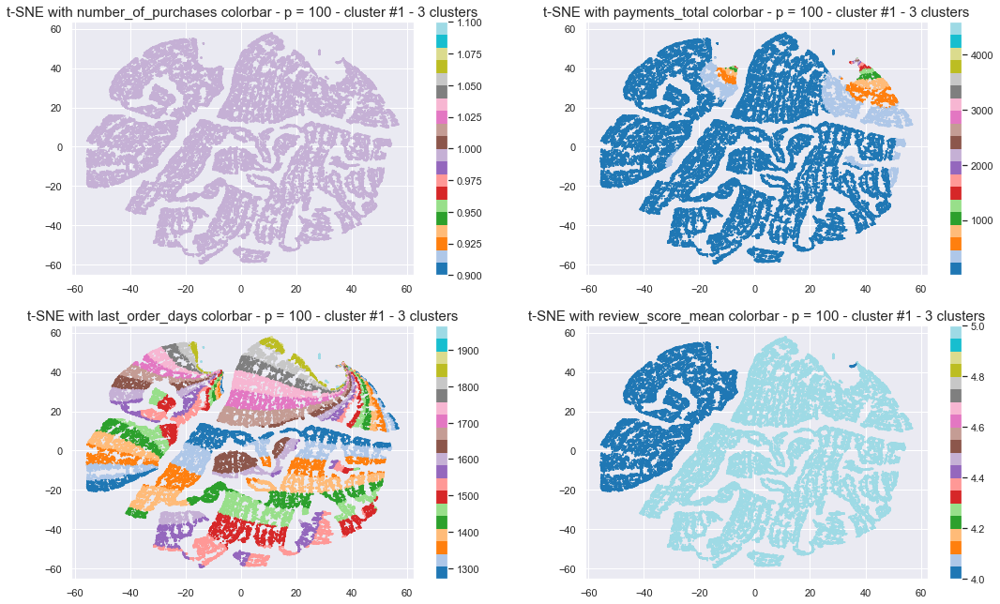

In [263]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_3_1 = pd.DataFrame(tsne_result_p100_3_1, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_3_1['tsne1'], 
                tsne_results_p100_3_1['tsne2'], 
                c = data_4_cluster_3_1[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #1 - 3 clusters', size = 15)
    plt.colorbar()

plt.show()

In [264]:
data_4_cluster_3_1.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_3
count,71166.0,71166.000000,71166.000000,71166.000000,71166.0
mean,1.0,134.564035,1508.470421,4.747646,1.0
std,0.0,196.084608,154.923904,0.434366,0.0
min,1.0,0.850000,1271.000000,4.000000,1.0
25%,1.0,45.000000,1382.000000,4.000000,1.0
50%,1.0,84.990000,1490.000000,5.000000,1.0
75%,1.0,149.650000,1622.000000,5.000000,1.0
max,1.0,4590.000000,1966.000000,5.000000,1.0


In [266]:
# Create a recap dataframe

cluster_3_1 = {'cluster' : ['0', '1'],
             'number_of_customers' : [len(X4_3_0), len(X4_3_1)],
             'number_of_purchases' : ['1 - 16', '1'], 
             'payments_total' : ['11.98 - 13440', '0.85 - 4590'],
             'last_order_days' : ['1267 - 1963', '1271 - 1966'],
             'review_score_mean' : ['1 - 5', '4 - 5']}

recap_clusters = pd.DataFrame(cluster_3_1)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,2873,1 - 16,11.98 - 13440,1267 - 1963,1 - 5
1,1,71166,1,0.85 - 4590,1271 - 1966,4 - 5


## 6) c) Cluster #2

In [267]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_3_2)
X4_3_2_scaled = std_scale.transform(X4_3_2)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_3_2 = tsne.fit_transform(X4_3_2_scaled)
tsne_result_p100_3_2.shape

(20682, 2)

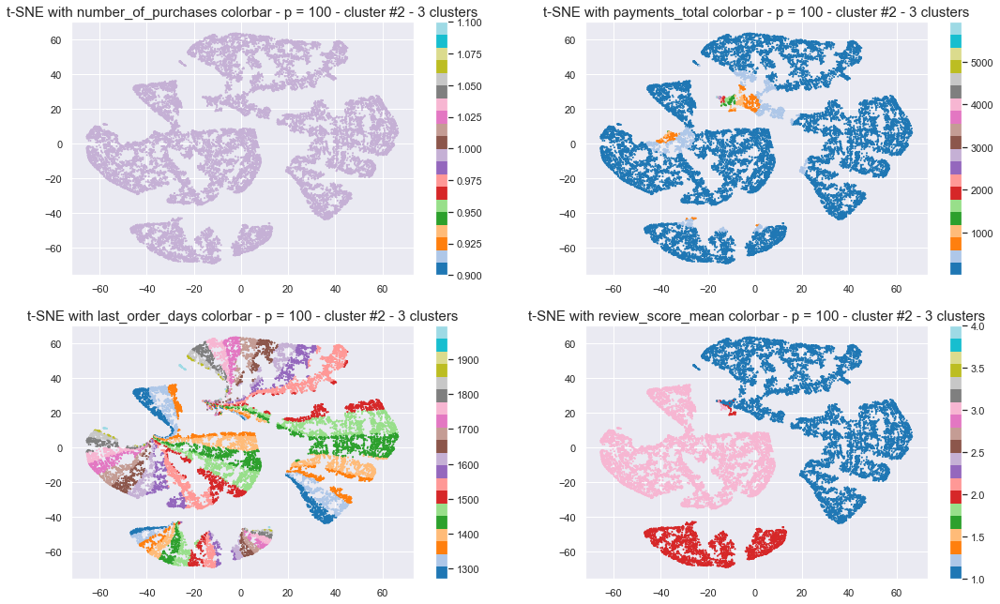

In [268]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_3_2 = pd.DataFrame(tsne_result_p100_3_2, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_3_2['tsne1'], 
                tsne_results_p100_3_2['tsne2'], 
                c = data_4_cluster_3_2[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #2 - 3 clusters', size = 15)
    plt.colorbar()

plt.show()

In [269]:
data_4_cluster_3_2.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_3
count,20682.0,20682.000000,20682.000000,20682.000000,20682.0
mean,1.0,150.192203,1515.295088,1.874819,2.0
std,0.0,228.109507,147.854595,0.919119,0.0
min,1.0,3.500000,1271.000000,1.000000,2.0
25%,1.0,49.000000,1408.000000,1.000000,2.0
50%,1.0,89.990000,1491.000000,2.000000,2.0
75%,1.0,160.000000,1606.000000,3.000000,2.0
max,1.0,5934.600000,1995.000000,4.000000,2.0


In [270]:
# Create a recap dataframe

cluster_3_2 = {'cluster' : ['0', '1', '2'],
             'number_of_customers' : [len(X4_3_0), len(X4_3_1), len(X4_3_2)],
             'number_of_purchases' : ['1 - 16', '1', '1'], 
             'payments_total' : ['11.98 - 13440', '0.85 - 4590', '3.50 - 5934,60'],
             'last_order_days' : ['1267 - 1963', '1271 - 1966', '1271 - 1995'],
             'review_score_mean' : ['1 - 5', '4 - 5', '1 > 2 > 3 >> 4']}

recap_clusters = pd.DataFrame(cluster_3_2)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,2873,1 - 16,11.98 - 13440,1267 - 1963,1 - 5
1,1,71166,1,0.85 - 4590,1271 - 1966,4 - 5
2,2,20682,1,"3.50 - 5934,60",1271 - 1995,1 > 2 > 3 >> 4


In [273]:
recap_clusters = recap_clusters.assign(description = ['1 purchase to 16 purchases - low to high payments_total - low number of customers',
                                                     '1 purchase - high review score - high number of customers',
                                                     '1 purchase - low to medium review score'])
recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean,description
0,0,2873,1 - 16,11.98 - 13440,1267 - 1963,1 - 5,1 purchase to 16 purchases - low to high payments_total - low number of customers
1,1,71166,1,0.85 - 4590,1271 - 1966,4 - 5,1 purchase - high review score - high number of customers
2,2,20682,1,"3.50 - 5934,60",1271 - 1995,1 > 2 > 3 >> 4,1 purchase - low to medium review score


# 7) Observation and analysis of the 4 KMeans Clusters

In [274]:
from sklearn.cluster import KMeans
from sklearn import metrics

# Run local implementation of kmeans with 4 clusters
km = KMeans(n_clusters = 4, 
            max_iter = 100,
            n_init = 10,
            init = 'k-means++')
km.fit(X4_scaled)

labels_kmeans_4_clusters = km.labels_
data_4['labels_kmeans_4'] = labels_kmeans_4_clusters

In [275]:
list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_kmeans_4']

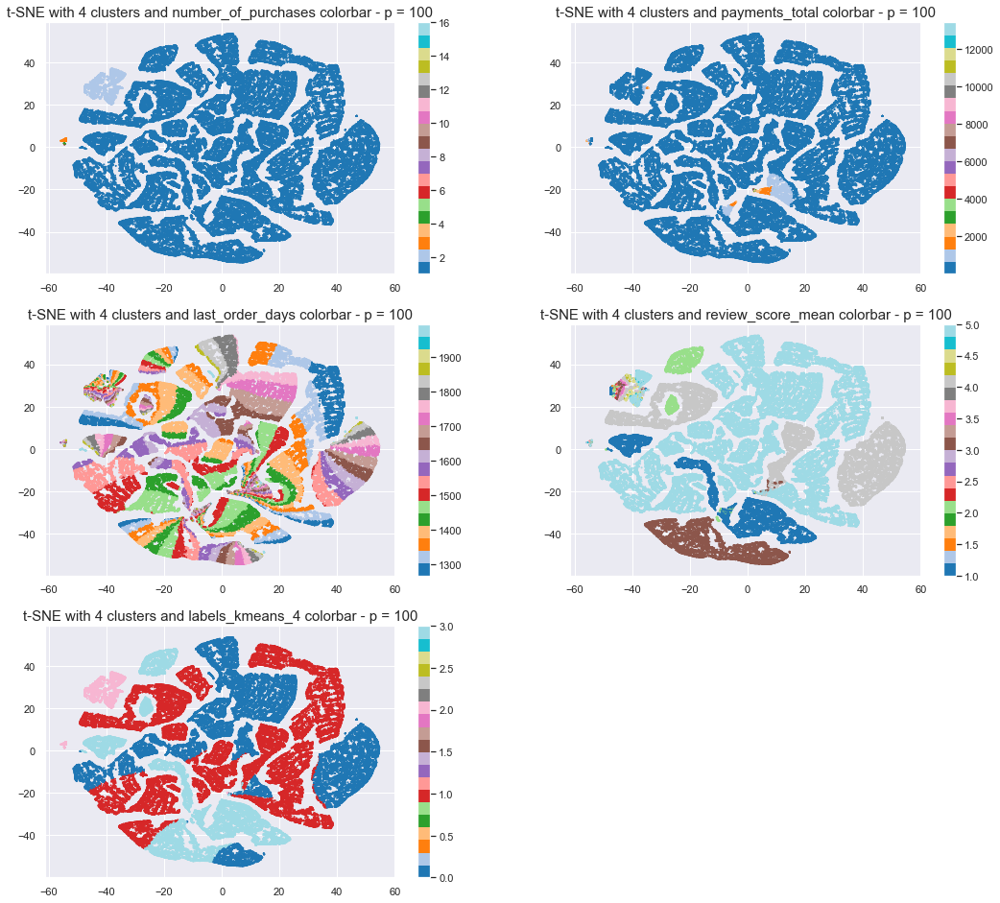

In [276]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with 4 clusters and '+ feat + ' colorbar - p = 100', size = 15)
    plt.colorbar()

plt.show()

In [277]:
data_4_4_clusters = data_4[['number_of_purchases',
                          'payments_total',
                          'last_order_days',
                          'review_score_mean',
                          'labels_kmeans_4']]
data_4_4_clusters

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_4
Customer,,,,,
8c446b198f0c92d5db58d3c8eacd3a11,1,196.80,1274,5.0,1
0c7f5da7d9d33d16ddc25dfafcc513ce,1,89.00,1289,5.0,1
8b27e23ca14dc7d4d8e429abda30b5fb,1,99.80,1292,5.0,1
3c068da825c04776514f05089b83ef6b,1,99.80,1296,5.0,1
3cc1026f5863d3b5fc44bd92bad50cee,1,94.60,1306,5.0,1
...,...,...,...,...,...
2e15add79c76241beffe812a24ad3a31,1,129.80,1965,1.0,3
a9530b74fe56ca4be9e5f2c7e7c4175a,1,119.80,1965,1.0,3
f176923a0a4ab546c7287791ccb82193,1,47.80,1965,5.0,0


In [278]:
data_4_cluster_4_0 = data_4_4_clusters.loc[data_4_4_clusters['labels_kmeans_4'] == 0]
data_4_cluster_4_1 = data_4_4_clusters.loc[data_4_4_clusters['labels_kmeans_4'] == 1]
data_4_cluster_4_2 = data_4_4_clusters.loc[data_4_4_clusters['labels_kmeans_4'] == 2]
data_4_cluster_4_3 = data_4_4_clusters.loc[data_4_4_clusters['labels_kmeans_4'] == 3]

In [279]:
X4_4_0 = data_4_cluster_4_0[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_4_1 = data_4_cluster_4_1[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_4_2 = data_4_cluster_4_2[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_4_3 = data_4_cluster_4_3[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values

In [280]:
print("shape X4_4_0 : ", X4_4_0.shape)
print("shape X4_4_1 : ", X4_4_1.shape)
print("shape X4_4_2 : ", X4_4_2.shape)
print("shape X4_4_3 : ", X4_4_3.shape)

shape X4_4_0 :  (32313, 4)
shape X4_4_1 :  (42740, 4)
shape X4_4_2 :  (2873, 4)
shape X4_4_3 :  (16795, 4)


## 7) a) Cluster #0

In [281]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_4_0)
X4_4_0_scaled = std_scale.transform(X4_4_0)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_4_0 = tsne.fit_transform(X4_4_0_scaled)
tsne_result_p100_4_0.shape

(32313, 2)

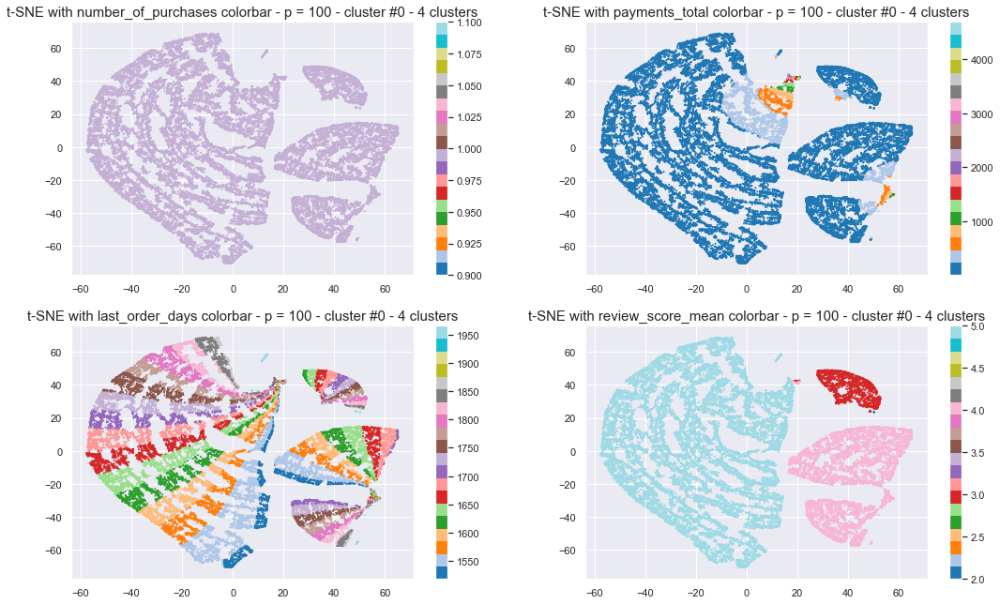

In [282]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_4_0 = pd.DataFrame(tsne_result_p100_4_0, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_4_0['tsne1'], 
                tsne_results_p100_4_0['tsne2'], 
                c = data_4_cluster_4_0[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #0 - 4 clusters', size = 15)
    plt.colorbar()

plt.show()

In [283]:
data_4_cluster_4_0.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_4
count,32313.0,32313.000000,32313.000000,32313.000000,32313.0
mean,1.0,136.028802,1664.343082,4.633027,0.0
std,0.0,198.601246,95.105179,0.595395,0.0
min,1.0,2.290000,1518.000000,2.000000,0.0
25%,1.0,45.900000,1581.000000,4.000000,0.0
50%,1.0,84.940000,1654.000000,5.000000,0.0
75%,1.0,149.900000,1736.000000,5.000000,0.0
max,1.0,4690.000000,1966.000000,5.000000,0.0


In [284]:
# Create a recap dataframe

cluster_4_0 = {'cluster' : ['0'],
             'number_of_customers' : [len(X4_4_0)],
             'number_of_purchases' : ['1'], 
             'payments_total' : ['2.29 - 4690'],
             'last_order_days' : ['1518 - 1966'],
             'review_score_mean' : ['2 << 3 < 4 < 5']}

recap_clusters = pd.DataFrame(cluster_4_0)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,32313,1,2.29 - 4690,1518 - 1966,2 << 3 < 4 < 5


## 7) b) Cluster #1

In [285]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_4_1)
X4_4_1_scaled = std_scale.transform(X4_4_1)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_4_1 = tsne.fit_transform(X4_4_1_scaled)
tsne_result_p100_4_1.shape

(42740, 2)

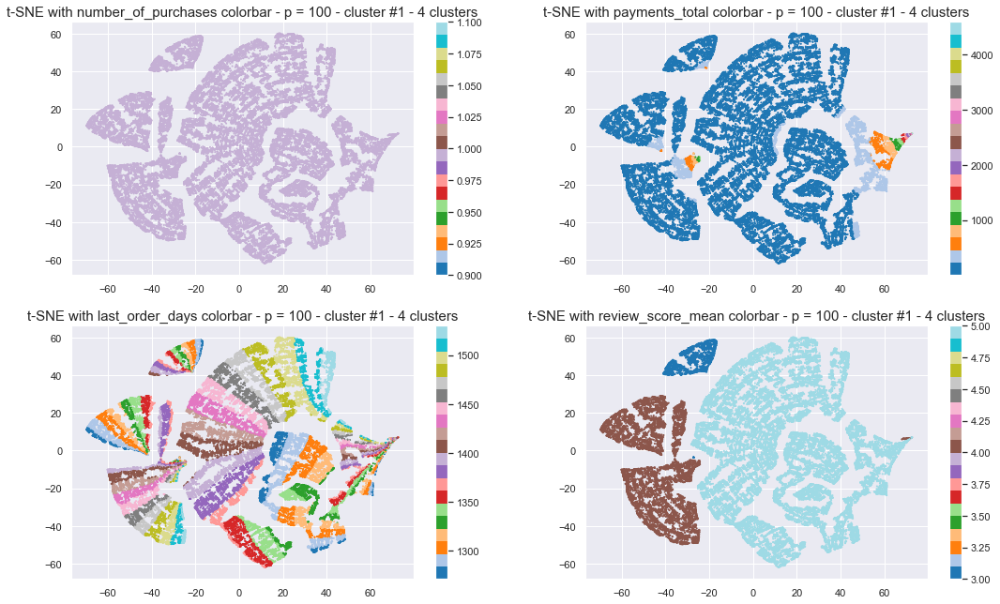

In [286]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_4_1 = pd.DataFrame(tsne_result_p100_4_1, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_4_1['tsne1'], 
                tsne_results_p100_4_1['tsne2'], 
                c = data_4_cluster_4_1[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #1 - 4 clusters', size = 15)
    plt.colorbar()

plt.show()

In [287]:
data_4_cluster_4_1.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_4
count,42740.0,42740.000000,42740.000000,42740.000000,42740.0
mean,1.0,131.246455,1393.211348,4.675175,1.0
std,0.0,189.136917,72.599984,0.556364,0.0
min,1.0,0.850000,1271.000000,3.000000,1.0
25%,1.0,44.990000,1330.000000,4.000000,1.0
50%,1.0,84.900000,1390.000000,5.000000,1.0
75%,1.0,149.000000,1455.000000,5.000000,1.0
max,1.0,4590.000000,1530.000000,5.000000,1.0


In [288]:
# Create a recap dataframe

cluster_4_1 = {'cluster' : ['0', '1'],
             'number_of_customers' : [len(X4_4_0), len(X4_4_1)],
             'number_of_purchases' : ['1', '1'], 
             'payments_total' : ['2.29 - 4690', '0.85 - 4560'],
             'last_order_days' : ['1518 - 1966', '1271 - 1530'],
             'review_score_mean' : ['2 << 3 < 4 < 5', '3 < 4 < 5']}

recap_clusters = pd.DataFrame(cluster_4_1)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,32313,1,2.29 - 4690,1518 - 1966,2 << 3 < 4 < 5
1,1,42740,1,0.85 - 4560,1271 - 1530,3 < 4 < 5


## 7) c) Cluster #2

In [289]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_4_2)
X4_4_2_scaled = std_scale.transform(X4_4_2)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_4_2 = tsne.fit_transform(X4_4_2_scaled)
tsne_result_p100_4_2.shape

(2873, 2)

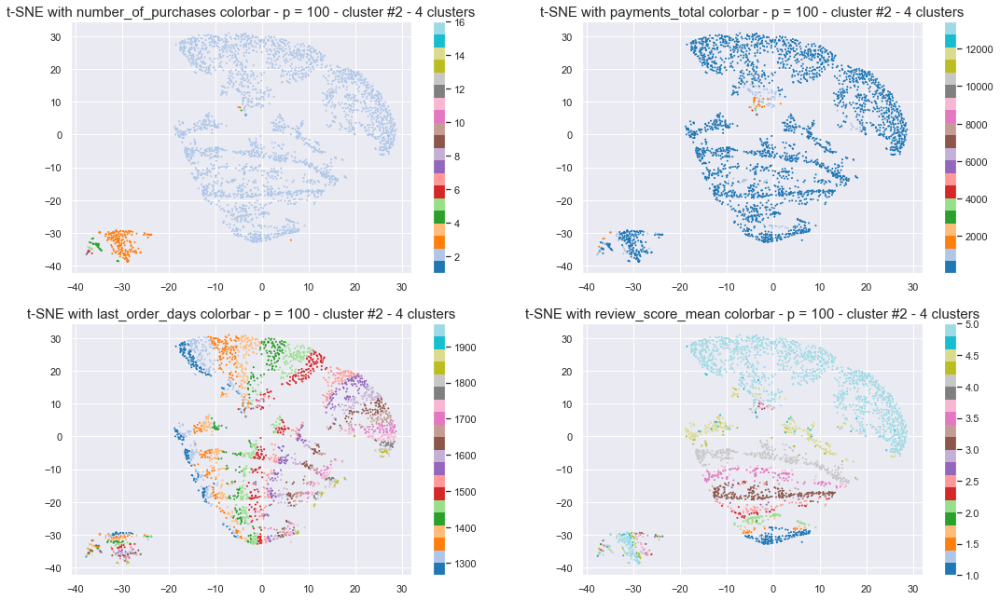

In [290]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_4_2 = pd.DataFrame(tsne_result_p100_4_2, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_4_2['tsne1'], 
                tsne_results_p100_4_2['tsne2'], 
                c = data_4_cluster_4_2[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #2 - 4 clusters', size = 15)
    plt.colorbar()

plt.show()

In [291]:
data_4_cluster_4_2.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_4
count,2873.000000,2873.000000,2873.000000,2873.000000,2873.0
mean,2.112426,272.984943,1492.767490,4.139144,2.0
std,0.511254,446.212135,145.101651,1.143763,0.0
min,1.000000,11.980000,1267.000000,1.000000,2.0
25%,2.000000,112.800000,1376.000000,3.500000,2.0
50%,2.000000,181.900000,1472.000000,4.571429,2.0
75%,2.000000,304.900000,1593.000000,5.000000,2.0
max,16.000000,13440.000000,1963.000000,5.000000,2.0


In [292]:
# Create a recap dataframe

cluster_4_2 = {'cluster' : ['0', '1', '2'],
             'number_of_customers' : [len(X4_4_0), len(X4_4_1), len(X4_4_2)],
             'number_of_purchases' : ['1', '1', '1 - 16'], 
             'payments_total' : ['2.29 - 4690', '0.85 - 4560', '11.98 - 13440'],
             'last_order_days' : ['1518 - 1966', '1271 - 1530', '1267 - 1963'],
             'review_score_mean' : ['2 << 3 < 4 < 5', '3 < 4 < 5', '1 - 5']}

recap_clusters = pd.DataFrame(cluster_4_2)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,32313,1,2.29 - 4690,1518 - 1966,2 << 3 < 4 < 5
1,1,42740,1,0.85 - 4560,1271 - 1530,3 < 4 < 5
2,2,2873,1 - 16,11.98 - 13440,1267 - 1963,1 - 5


## 7) c) Cluster #3

In [293]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_4_3)
X4_4_3_scaled = std_scale.transform(X4_4_3)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_4_3 = tsne.fit_transform(X4_4_3_scaled)
tsne_result_p100_4_3.shape

(16795, 2)

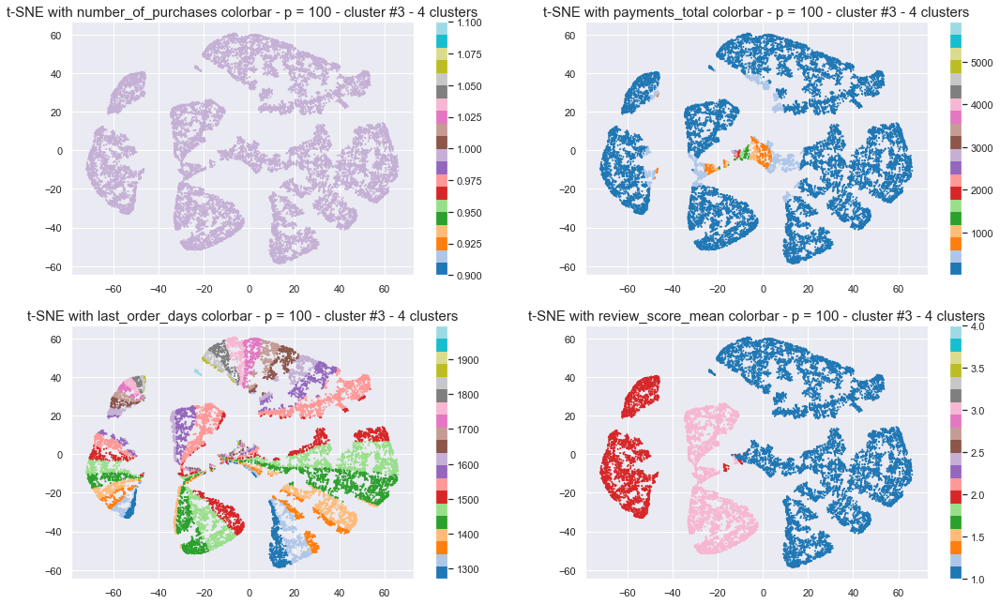

In [294]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_4_3 = pd.DataFrame(tsne_result_p100_4_3, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_4_3['tsne1'], 
                tsne_results_p100_4_3['tsne2'], 
                c = data_4_cluster_4_3[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #3 - 4 clusters', size = 15)
    plt.colorbar()

plt.show()

In [296]:
data_4_cluster_4_3.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_4
count,16795.0,16795.000000,16795.000000,16795.000000,16795.0
mean,1.0,159.433587,1510.292825,1.614885,3.0
std,0.0,244.398522,131.560747,0.824880,0.0
min,1.0,3.540000,1271.000000,1.000000,3.0
25%,1.0,49.900000,1428.000000,1.000000,3.0
50%,1.0,95.000000,1490.000000,1.000000,3.0
75%,1.0,169.900000,1570.000000,2.000000,3.0
max,1.0,5934.600000,1995.000000,4.000000,3.0


In [297]:
# Create a recap dataframe

cluster_4_3 = {'cluster' : ['0', '1', '2', '3'],
             'number_of_customers' : [len(X4_4_0), len(X4_4_1), len(X4_4_2), len(X4_4_3)],
             'number_of_purchases' : ['1', '1', '1 - 16', '1'], 
             'payments_total' : ['2.29 - 4690', '0.85 - 4560', '11.98 - 13440', '3.54 - 5934.60'],
             'last_order_days' : ['1518 - 1966', '1271 - 1530', '1267 - 1963', '1271 - 1995'],
             'review_score_mean' : ['2 << 3 < 4 < 5', '3 < 4 < 5', '1 - 5', '1 - 3 >> 4']}

recap_clusters = pd.DataFrame(cluster_4_3)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,32313,1,2.29 - 4690,1518 - 1966,2 << 3 < 4 < 5
1,1,42740,1,0.85 - 4560,1271 - 1530,3 < 4 < 5
2,2,2873,1 - 16,11.98 - 13440,1267 - 1963,1 - 5
3,3,16795,1,3.54 - 5934.60,1271 - 1995,1 - 3 >> 4


In [298]:
recap_clusters = recap_clusters.assign(description = ['1 purchase - middle to high review score - did not order recently',
                                                     '1 purchase - middle to high review score - ordered recently',
                                                     '1 purchase to 16 purchase - high payments_total - low number of customers',
                                                     '1 purchase - low to middle review score'])
recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean,description
0,0,32313,1,2.29 - 4690,1518 - 1966,2 << 3 < 4 < 5,1 purchase - middle to high review score - did not order recently
1,1,42740,1,0.85 - 4560,1271 - 1530,3 < 4 < 5,1 purchase - middle to high review score - ordered recently
2,2,2873,1 - 16,11.98 - 13440,1267 - 1963,1 - 5,1 purchase to 16 purchase - high payments_total - low number of customers
3,3,16795,1,3.54 - 5934.60,1271 - 1995,1 - 3 >> 4,1 purchase - low to middle review score


# 8) Observation and analysis of the 6 KMeans Clusters

In [300]:
from sklearn.cluster import KMeans
from sklearn import metrics

# Run local implementation of kmeans with 6 clusters
km = KMeans(n_clusters = 6, 
            max_iter = 100,
            n_init = 10,
            init = 'k-means++')
km.fit(X4_scaled)

labels_kmeans_6_clusters = km.labels_
data_4['labels_kmeans_6'] = labels_kmeans_6_clusters

In [301]:
list_feat_4_and_label = ['number_of_purchases',
                         'payments_total',
                         'last_order_days',
                         'review_score_mean',
                         'labels_kmeans_6']

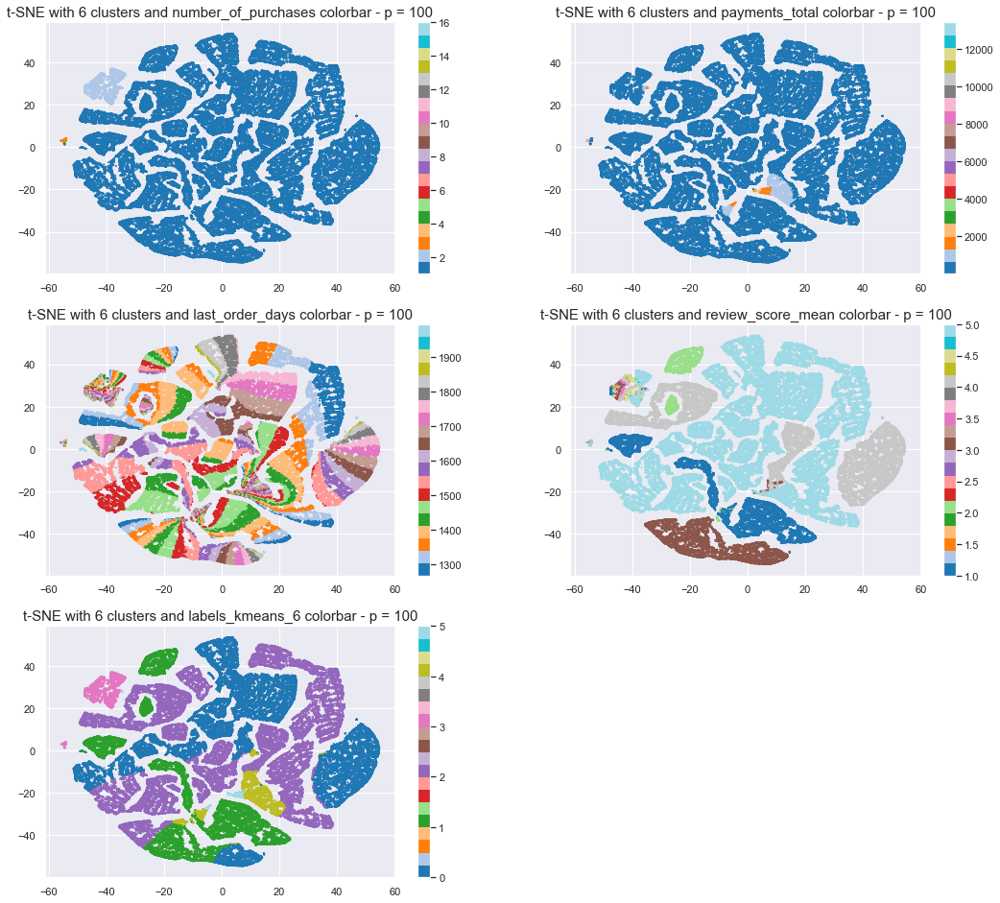

In [302]:
plt.figure(figsize = (18,9))
plt.subplots_adjust(top = 1.5)

tsne_results_p100 = pd.DataFrame(tsne_result_p100, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4_and_label):    
    plt.subplot(3,2,index+1)
    plt.scatter(tsne_results_p100['tsne1'], 
                tsne_results_p100['tsne2'], 
                c = data_4.get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with 6 clusters and '+ feat + ' colorbar - p = 100', size = 15)
    plt.colorbar()

plt.show()

In [303]:
data_4_6_clusters = data_4[['number_of_purchases',
                          'payments_total',
                          'last_order_days',
                          'review_score_mean',
                          'labels_kmeans_6']]
data_4_6_clusters

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_6
Customer,,,,,
8c446b198f0c92d5db58d3c8eacd3a11,1,196.80,1274,5.0,2
0c7f5da7d9d33d16ddc25dfafcc513ce,1,89.00,1289,5.0,2
8b27e23ca14dc7d4d8e429abda30b5fb,1,99.80,1292,5.0,2
3c068da825c04776514f05089b83ef6b,1,99.80,1296,5.0,2
3cc1026f5863d3b5fc44bd92bad50cee,1,94.60,1306,5.0,2
...,...,...,...,...,...
2e15add79c76241beffe812a24ad3a31,1,129.80,1965,1.0,1
a9530b74fe56ca4be9e5f2c7e7c4175a,1,119.80,1965,1.0,1
f176923a0a4ab546c7287791ccb82193,1,47.80,1965,5.0,0


In [304]:
data_4_cluster_6_0 = data_4_6_clusters.loc[data_4_6_clusters['labels_kmeans_6'] == 0]
data_4_cluster_6_1 = data_4_6_clusters.loc[data_4_6_clusters['labels_kmeans_6'] == 1]
data_4_cluster_6_2 = data_4_6_clusters.loc[data_4_6_clusters['labels_kmeans_6'] == 2]
data_4_cluster_6_3 = data_4_6_clusters.loc[data_4_6_clusters['labels_kmeans_6'] == 3]
data_4_cluster_6_4 = data_4_6_clusters.loc[data_4_6_clusters['labels_kmeans_6'] == 4]
data_4_cluster_6_5 = data_4_6_clusters.loc[data_4_6_clusters['labels_kmeans_6'] == 5]

In [305]:
X4_6_0 = data_4_cluster_6_0[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_6_1 = data_4_cluster_6_1[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_6_2 = data_4_cluster_6_2[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_6_3 = data_4_cluster_6_3[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_6_4 = data_4_cluster_6_4[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values
X4_6_5 = data_4_cluster_6_5[['number_of_purchases','payments_total','last_order_days','review_score_mean']].values

In [306]:
print("shape X4_6_0 : ", X4_6_0.shape)
print("shape X4_6_1 : ", X4_6_1.shape)
print("shape X4_6_2 : ", X4_6_2.shape)
print("shape X4_6_3 : ", X4_6_3.shape)
print("shape X4_6_4 : ", X4_6_4.shape)
print("shape X4_6_5 : ", X4_6_5.shape)

shape X4_6_0 :  (30911, 4)
shape X4_6_1 :  (16168, 4)
shape X4_6_2 :  (40942, 4)
shape X4_6_3 :  (2847, 4)
shape X4_6_4 :  (3369, 4)
shape X4_6_5 :  (484, 4)


## 8) a) Cluster #0

In [307]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_6_0)
X4_6_0_scaled = std_scale.transform(X4_6_0)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_6_0 = tsne.fit_transform(X4_6_0_scaled)
tsne_result_p100_6_0.shape

(30911, 2)

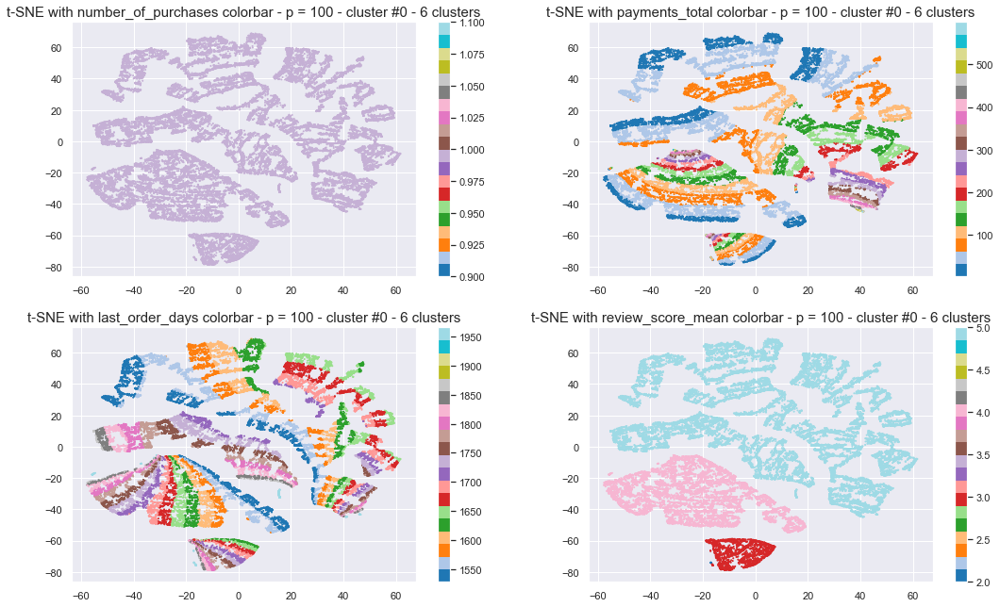

In [308]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_6_0 = pd.DataFrame(tsne_result_p100_6_0, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_6_0['tsne1'], 
                tsne_results_p100_6_0['tsne2'], 
                c = data_4_cluster_6_0[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #0 - 6 clusters', size = 15)
    plt.colorbar()

plt.show()

In [309]:
data_4_cluster_6_0.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_6
count,30911.0,30911.000000,30911.000000,30911.000000,30911.0
mean,1.0,103.590537,1664.759568,4.632234,0.0
std,0.0,83.743106,95.133456,0.596095,0.0
min,1.0,2.290000,1528.000000,2.000000,0.0
25%,1.0,44.900000,1581.000000,4.000000,0.0
50%,1.0,79.900000,1655.000000,5.000000,0.0
75%,1.0,137.990000,1737.000000,5.000000,0.0
max,1.0,599.600000,1966.000000,5.000000,0.0


In [310]:
# Create a recap dataframe

cluster_6_0 = {'cluster' : ['0'],
             'number_of_customers' : [len(X4_6_0)],
             'number_of_purchases' : ['1'], 
             'payments_total' : ['2.29 - 599.60'],
             'last_order_days' : ['1528 - 1966'],
             'review_score_mean' : ['2 << 3 < 4 < 5']}

recap_clusters = pd.DataFrame(cluster_6_0)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,30911,1,2.29 - 599.60,1528 - 1966,2 << 3 < 4 < 5


## 8) b) Cluster #1

In [311]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_6_1)
X4_6_1_scaled = std_scale.transform(X4_6_1)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_6_1 = tsne.fit_transform(X4_6_1_scaled)
tsne_result_p100_6_1.shape

(16168, 2)

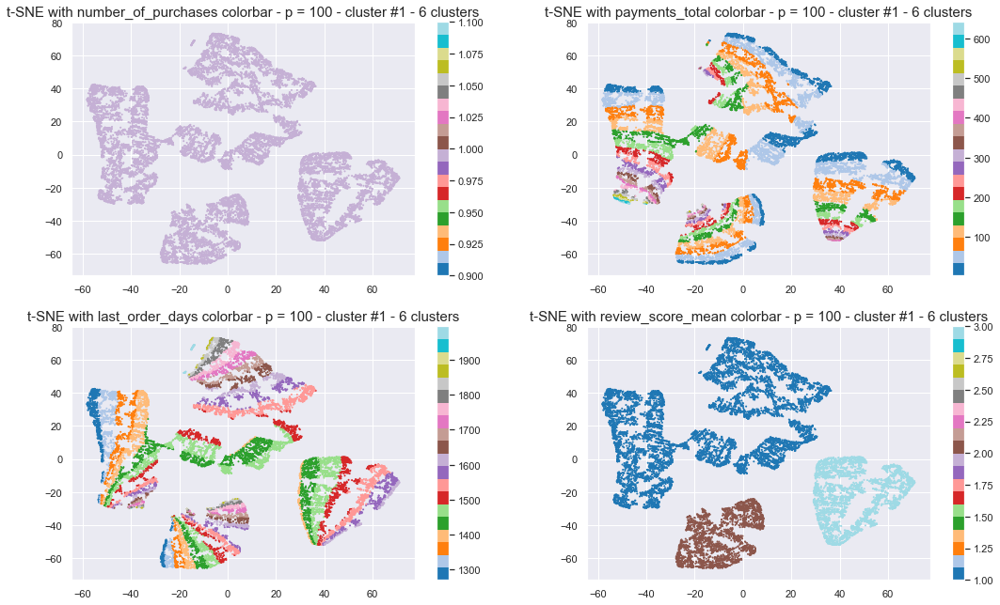

In [312]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_6_1 = pd.DataFrame(tsne_result_p100_6_1, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_6_1['tsne1'], 
                tsne_results_p100_6_1['tsne2'], 
                c = data_4_cluster_6_1[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #1 - 6 clusters', size = 15)
    plt.colorbar()

plt.show()

In [313]:
data_4_cluster_6_1.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_6
count,16168.0,16168.00000,16168.000000,16168.000000,16168.0
mean,1.0,120.54324,1510.378464,1.613743,1.0
std,0.0,104.52923,131.244462,0.823843,0.0
min,1.0,3.54000,1271.000000,1.000000,1.0
25%,1.0,49.00000,1428.000000,1.000000,1.0
50%,1.0,89.90000,1490.000000,1.000000,1.0
75%,1.0,155.00000,1570.000000,2.000000,1.0
max,1.0,640.99000,1995.000000,3.000000,1.0


In [314]:
# Create a recap dataframe

cluster_6_1 = {'cluster' : ['0', '1'],
             'number_of_customers' : [len(X4_6_0), len(X4_6_1)],
             'number_of_purchases' : ['1', '1'], 
             'payments_total' : ['2.29 - 599.60', '3.54 - 640.99'],
             'last_order_days' : ['1528 - 1966', '1271 - 1995'],
             'review_score_mean' : ['2 << 3 < 4 < 5', '1 - 3']}

recap_clusters = pd.DataFrame(cluster_6_1)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,30911,1,2.29 - 599.60,1528 - 1966,2 << 3 < 4 < 5
1,1,16168,1,3.54 - 640.99,1271 - 1995,1 - 3


## 8) c) Cluster #2

In [315]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_6_2)
X4_6_2_scaled = std_scale.transform(X4_6_2)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_6_2 = tsne.fit_transform(X4_6_2_scaled)
tsne_result_p100_6_2.shape

(40942, 2)

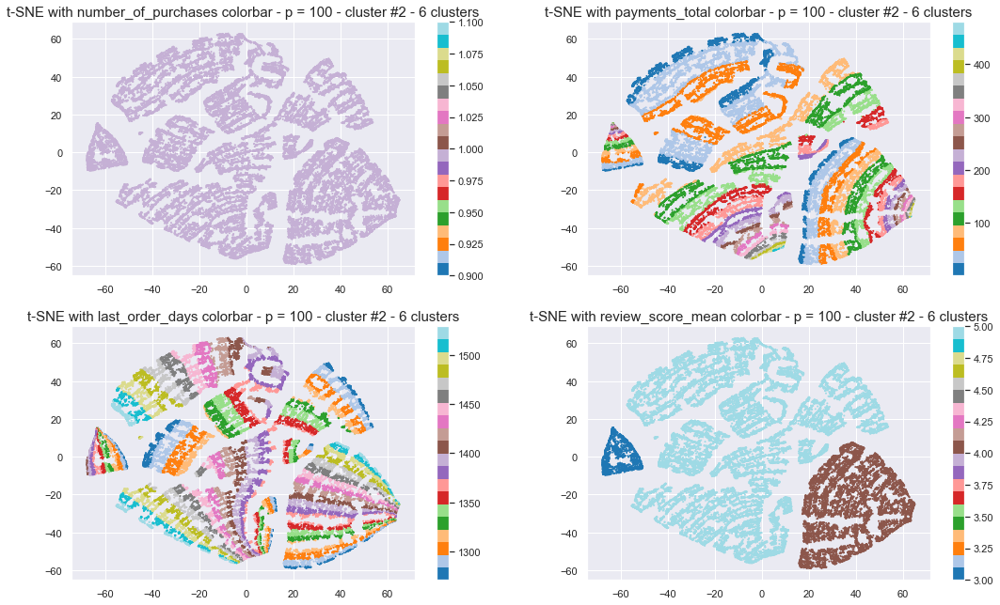

In [316]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_6_2 = pd.DataFrame(tsne_result_p100_6_2, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_6_2['tsne1'], 
                tsne_results_p100_6_2['tsne2'], 
                c = data_4_cluster_6_2[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #2 - 6 clusters', size = 15)
    plt.colorbar()

plt.show()

In [317]:
data_4_cluster_6_2.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_6
count,40942.0,40942.000000,40942.000000,40942.000000,40942.0
mean,1.0,102.559995,1393.060696,4.675956,2.0
std,0.0,80.668483,72.724998,0.555903,0.0
min,1.0,0.850000,1271.000000,3.000000,2.0
25%,1.0,43.900000,1330.000000,4.000000,2.0
50%,1.0,79.900000,1390.000000,5.000000,2.0
75%,1.0,138.900000,1455.000000,5.000000,2.0
max,1.0,479.800000,1529.000000,5.000000,2.0


In [318]:
# Create a recap dataframe

cluster_6_2 = {'cluster' : ['0', '1', '2'],
             'number_of_customers' : [len(X4_6_0), len(X4_6_1), len(X4_6_2)],
             'number_of_purchases' : ['1', '1', '1'], 
             'payments_total' : ['2.29 - 599.60', '3.54 - 640.99', '0.85 - 479.80'],
             'last_order_days' : ['1528 - 1966', '1271 - 1995', '1271 - 1529'],
             'review_score_mean' : ['2 << 3 < 4 < 5', '1 - 3', '3 < 4 < 5']}

recap_clusters = pd.DataFrame(cluster_6_2)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,30911,1,2.29 - 599.60,1528 - 1966,2 << 3 < 4 < 5
1,1,16168,1,3.54 - 640.99,1271 - 1995,1 - 3
2,2,40942,1,0.85 - 479.80,1271 - 1529,3 < 4 < 5


## 8) d) Cluster #3

In [319]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_6_3)
X4_6_3_scaled = std_scale.transform(X4_6_3)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_6_3 = tsne.fit_transform(X4_6_3_scaled)
tsne_result_p100_6_3.shape

(2847, 2)

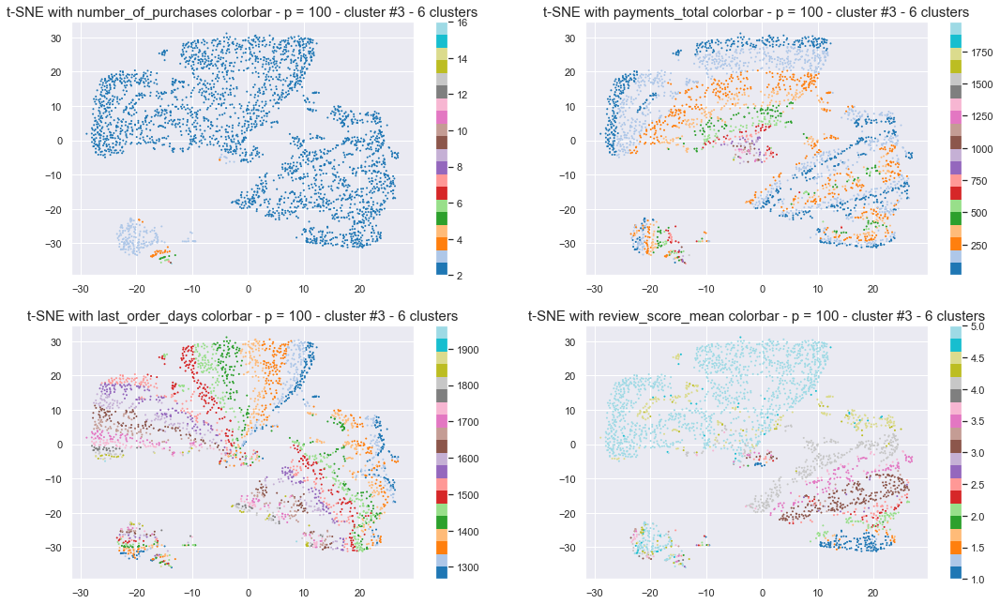

In [320]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_6_3 = pd.DataFrame(tsne_result_p100_6_3, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_6_3['tsne1'], 
                tsne_results_p100_6_3['tsne2'], 
                c = data_4_cluster_6_3[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #3 - 6 clusters', size = 15)
    plt.colorbar()

plt.show()

In [321]:
data_4_cluster_6_3.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_6
count,2847.000000,2847.000000,2847.000000,2847.000000,2847.0
mean,2.113804,245.094640,1492.555321,4.140205,3.0
std,0.510304,213.933538,144.890255,1.141543,0.0
min,2.000000,11.980000,1267.000000,1.000000,3.0
25%,2.000000,112.095000,1376.000000,3.500000,3.0
50%,2.000000,179.970000,1472.000000,4.500000,3.0
75%,2.000000,299.900000,1591.500000,5.000000,3.0
max,16.000000,1980.280000,1963.000000,5.000000,3.0


In [322]:
# Create a recap dataframe

cluster_6_3 = {'cluster' : ['0', '1', '2', '3'],
             'number_of_customers' : [len(X4_6_0), len(X4_6_1), len(X4_6_2), len(X4_6_3)],
             'number_of_purchases' : ['1', '1', '1', '2 - 16'], 
             'payments_total' : ['2.29 - 599.60', '3.54 - 640.99', '0.85 - 479.80', '11.98 - 1980.28'],
             'last_order_days' : ['1528 - 1966', '1271 - 1995', '1271 - 1529', '1267 - 1963'],
             'review_score_mean' : ['2 << 3 < 4 < 5', '1 - 3', '3 < 4 < 5', '1 - 5']}

recap_clusters = pd.DataFrame(cluster_6_3)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,30911,1,2.29 - 599.60,1528 - 1966,2 << 3 < 4 < 5
1,1,16168,1,3.54 - 640.99,1271 - 1995,1 - 3
2,2,40942,1,0.85 - 479.80,1271 - 1529,3 < 4 < 5
3,3,2847,2 - 16,11.98 - 1980.28,1267 - 1963,1 - 5


## 8) e) Cluster #4

In [323]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_6_4)
X4_6_4_scaled = std_scale.transform(X4_6_4)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_6_4 = tsne.fit_transform(X4_6_4_scaled)
tsne_result_p100_6_4.shape

(3369, 2)

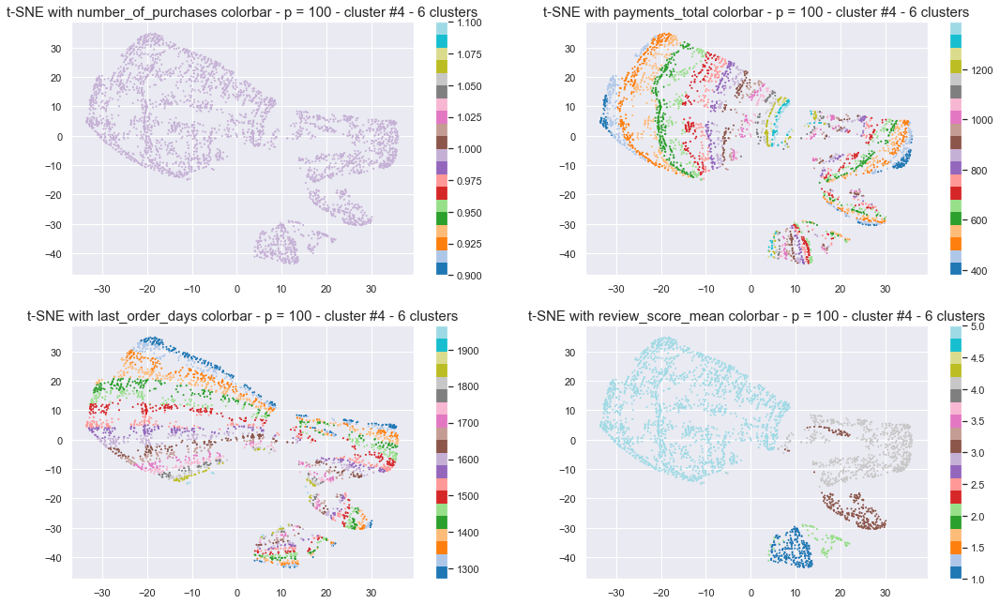

In [324]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_6_4 = pd.DataFrame(tsne_result_p100_6_4, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_6_4['tsne1'], 
                tsne_results_p100_6_4['tsne2'], 
                c = data_4_cluster_6_4[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #4 - 6 clusters', size = 15)
    plt.colorbar()

plt.show()

In [325]:
data_4_cluster_6_4.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_6
count,3369.0,3369.000000,3369.000000,3369.000000,3369.0
mean,1.0,719.734405,1509.804096,4.221134,4.0
std,0.0,234.383479,148.073943,1.210879,0.0
min,1.0,379.000000,1272.000000,1.000000,4.0
25%,1.0,539.800000,1390.000000,4.000000,4.0
50%,1.0,659.000000,1494.000000,5.000000,4.0
75%,1.0,849.990000,1612.000000,5.000000,4.0
max,1.0,1390.000000,1965.000000,5.000000,4.0


In [326]:
# Create a recap dataframe

cluster_6_4 = {'cluster' : ['0', '1', '2', '3', '4'],
             'number_of_customers' : [len(X4_6_0), len(X4_6_1), len(X4_6_2), len(X4_6_3), len(X4_6_4)],
             'number_of_purchases' : ['1', '1', '1', '2 - 16', '1'], 
             'payments_total' : ['2.29 - 599.60', '3.54 - 640.99', '0.85 - 479.80', '11.98 - 1980.28', '379 - 1390'],
             'last_order_days' : ['1528 - 1966', '1271 - 1995', '1271 - 1529', '1267 - 1963', '1272 - 1965'],
             'review_score_mean' : ['2 << 3 < 4 < 5', '1 - 3', '3 < 4 < 5', '1 - 5', '1 - 5']}

recap_clusters = pd.DataFrame(cluster_6_4)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,30911,1,2.29 - 599.60,1528 - 1966,2 << 3 < 4 < 5
1,1,16168,1,3.54 - 640.99,1271 - 1995,1 - 3
2,2,40942,1,0.85 - 479.80,1271 - 1529,3 < 4 < 5
3,3,2847,2 - 16,11.98 - 1980.28,1267 - 1963,1 - 5
4,4,3369,1,379 - 1390,1272 - 1965,1 - 5


## 8) f) Cluster #5

In [328]:
# Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X4_6_5)
X4_6_5_scaled = std_scale.transform(X4_6_5)

from sklearn.manifold import TSNE

# Perplexity = 100 (default perplexity = 30)
n_components = 2
tsne = TSNE(n_components,
            init = 'random',
            perplexity = 100,
            n_iter = 1000,
            random_state = 0)
tsne_result_p100_6_5 = tsne.fit_transform(X4_6_5_scaled)
tsne_result_p100_6_5.shape

(484, 2)

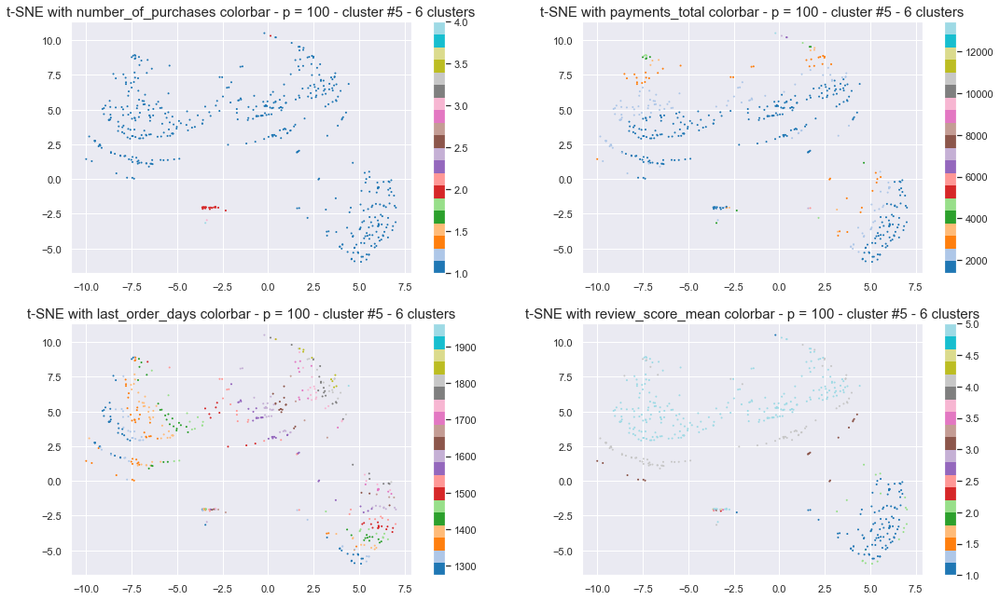

In [329]:
plt.figure(figsize = (18,6))
plt.subplots_adjust(top = 1.5)

tsne_results_p100_6_5 = pd.DataFrame(tsne_result_p100_6_5, columns=['tsne1', 'tsne2'])

for index, feat in enumerate(list_feat_4):    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results_p100_6_5['tsne1'], 
                tsne_results_p100_6_5['tsne2'], 
                c = data_4_cluster_6_5[['number_of_purchases',
                                     'payments_total',
                                     'last_order_days',
                                     'review_score_mean']].get(feat), 
                s = 1, 
                cmap = 'tab20')
    plt.title('t-SNE with '+ feat + ' colorbar - p = 100 - cluster #5 - 6 clusters', size = 15)
    plt.colorbar()

plt.show()

In [330]:
data_4_cluster_6_5.describe()

,number_of_purchases,payments_total,last_order_days,review_score_mean,labels_kmeans_6
count,484.000000,484.000000,484.000000,484.000000,484.0
mean,1.051653,2054.408760,1508.578512,3.736767,5.0
std,0.256221,934.788178,162.824958,1.616793,0.0
min,1.000000,1359.900000,1275.000000,1.000000,5.0
25%,1.000000,1589.990000,1373.000000,2.000000,5.0
50%,1.000000,1800.000000,1486.000000,5.000000,5.0
75%,1.000000,2160.000000,1618.500000,5.000000,5.0
max,4.000000,13440.000000,1962.000000,5.000000,5.0


In [331]:
# Create a recap dataframe

cluster_6_5 = {'cluster' : ['0', '1', '2', '3', '4', '5'],
             'number_of_customers' : [len(X4_6_0), len(X4_6_1), len(X4_6_2), len(X4_6_3), len(X4_6_4), len(X4_6_5)],
             'number_of_purchases' : ['1', '1', '1', '2 - 16', '1', '1 - 4'], 
             'payments_total' : ['2.29 - 599.60', '3.54 - 640.99', '0.85 - 479.80', '11.98 - 1980.28', '379 - 1390', '1359 - 13440'],
             'last_order_days' : ['1528 - 1966', '1271 - 1995', '1271 - 1529', '1267 - 1963', '1272 - 1965', '1275 - 1962'],
             'review_score_mean' : ['2 << 3 < 4 < 5', '1 - 3', '3 < 4 < 5', '1 - 5', '1 - 5', '1 - 5']}

recap_clusters = pd.DataFrame(cluster_6_5)

recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean
0,0,30911,1,2.29 - 599.60,1528 - 1966,2 << 3 < 4 < 5
1,1,16168,1,3.54 - 640.99,1271 - 1995,1 - 3
2,2,40942,1,0.85 - 479.80,1271 - 1529,3 < 4 < 5
3,3,2847,2 - 16,11.98 - 1980.28,1267 - 1963,1 - 5
4,4,3369,1,379 - 1390,1272 - 1965,1 - 5
5,5,484,1 - 4,1359 - 13440,1275 - 1962,1 - 5


In [333]:
recap_clusters = recap_clusters.assign(description = ['1 purchase - middle to high review score - did not order recently',
                                                     '1 purchase - low to middle review score',
                                                      '1 purchase - middle to high review score - ordered recently',
                                                     '2 to 16 purchases - low number of customers',
                                                     '1 purchase - high payments_total - low number of customers',
                                                     '1 to 4 purchases - very high payments_total - very low number of customers'])
recap_clusters

,cluster,number_of_customers,number_of_purchases,payments_total,last_order_days,review_score_mean,description
0,0,30911,1,2.29 - 599.60,1528 - 1966,2 << 3 < 4 < 5,1 purchase - middle to high review score - did not order recently
1,1,16168,1,3.54 - 640.99,1271 - 1995,1 - 3,1 purchase - low to middle review score
2,2,40942,1,0.85 - 479.80,1271 - 1529,3 < 4 < 5,1 purchase - middle to high review score - ordered recently
3,3,2847,2 - 16,11.98 - 1980.28,1267 - 1963,1 - 5,2 to 16 purchases - low number of customers
4,4,3369,1,379 - 1390,1272 - 1965,1 - 5,1 purchase - high payments_total - low number of customers
5,5,484,1 - 4,1359 - 13440,1275 - 1962,1 - 5,1 to 4 purchases - very high payments_total - very low number of customers
